In [1]:
import os
import datetime
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
import pathlib
import numpy as np

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os

for dirpath, dirnames, filenames in os.walk("/content/drive/MyDrive/dataset_tiger/train"):
  print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

There are 2 directories and 0 images in '/content/drive/MyDrive/dataset_tiger/train'.
There are 0 directories and 2481 images in '/content/drive/MyDrive/dataset_tiger/train/non_tiger'.
There are 0 directories and 1635 images in '/content/drive/MyDrive/dataset_tiger/train/tiger'.


In [4]:
# Setup data inputs
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMAGE_SHAPE = (299, 299)  # Adjusted for InceptionV3
BATCH_SIZE = 32

train_dir = "/content/drive/MyDrive/dataset_tiger/train/"
test_dir = "/content/drive/MyDrive/dataset_tiger/test"

train_datagen = ImageDataGenerator(rescale=1/255.)
test_datagen = ImageDataGenerator(rescale=1/255.)

print("Training images:")
train_data_10_percent = train_datagen.flow_from_directory(train_dir,
                                                           target_size=IMAGE_SHAPE,
                                                           batch_size=BATCH_SIZE,
                                                           class_mode="categorical")

print("Testing images:")
test_data = train_datagen.flow_from_directory(test_dir,
                                              target_size=IMAGE_SHAPE,
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

Training images:
Found 4116 images belonging to 2 classes.
Testing images:
Found 1042 images belonging to 2 classes.


In [ ]:
def create_tensorboard_callback(dir_name, experiment_name):
    log_dir = dir_name + "/" + experiment_name + "/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    print(f"Saving TensorBoard log files to: {log_dir}")
    return tensorboard_callback

In [ ]:
# InceptionV3 feature vector
inception_url = "https://tfhub.dev/google/imagenet/inception_v3/feature_vector/4"

In [ ]:
def create_inception_model(model_url, num_classes=2):
    feature_extractor_layer = hub.KerasLayer(model_url,
                                             trainable=False,
                                             name='feature_extraction_layer',
                                             input_shape=IMAGE_SHAPE+(3,))

    model = tf.keras.Sequential([
        feature_extractor_layer,
        layers.Dense(num_classes, activation='sigmoid', name='output_layer')
    ])

    return model

In [ ]:
# Create InceptionV3 model
inception_model = create_inception_model(inception_url, num_classes=2)

# Compile the model
inception_model.compile(loss='categorical_crossentropy',
                        optimizer=tf.keras.optimizers.Adam(),
                        metrics=['accuracy'])

In [ ]:
# Fit the model
inception_history = inception_model.fit(train_data_10_percent,
                                        epochs=30,
                                        steps_per_epoch=10,
                                        validation_data=test_data,
                                        validation_steps=10,
                                        callbacks=[create_tensorboard_callback(dir_name="tensorflow_hub",
                                                                               experiment_name="inceptionv3")])

Saving TensorBoard log files to: tensorflow_hub/inceptionv3/20240322-090809
Epoch 1/30
10/10 [==============================] - 275s 28s/step - loss: 0.4165 - accuracy: 0.8182 - val_loss: 0.2098 - val_accuracy: 0.9594
Epoch 2/30
10/10 [==============================] - 238s 25s/step - loss: 0.1380 - accuracy: 0.9812 - val_loss: 0.1187 - val_accuracy: 0.9750
Epoch 3/30
10/10 [==============================] - 193s 21s/step - loss: 0.1233 - accuracy: 0.9812 - val_loss: 0.0690 - val_accuracy: 0.9875
Epoch 4/30
10/10 [==============================] - 122s 13s/step - loss: 0.1397 - accuracy: 0.9656 - val_loss: 0.0789 - val_accuracy: 0.9781
Epoch 5/30
10/10 [==============================] - 96s 10s/step - loss: 0.0839 - accuracy: 0.9781 - val_loss: 0.0546 - val_accuracy: 0.9812
Epoch 6/30
10/10 [==============================] - 97s 10s/step - loss: 0.0843 - accuracy: 0.9750 - val_loss: 0.0548 - val_accuracy: 0.9875
Epoch 7/30
10/10 [==============================] - 70s 7s/step - loss: 0.

In [ ]:
# If you wanted to, you could really turn this into a helper function to load in with a helper.py script...
import matplotlib.pyplot as plt

# Plot the validation and training data separately
def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  plt.plot(epochs, loss, label='training loss',c='blue')
  plt.plot(epochs, val_loss, label='validation loss',c='red')
  plt.title('train and validation Loss')
  plt.xlabel('Epochs')
  plt.legend()

  # Plot accuracy
  plt.figure()
  plt.plot(epochs, accuracy, label='training accuracy',c='blue')
  plt.plot(epochs, val_accuracy, label='validation accuracy',c='red')
  plt.title('Train and validation Accuracy')
  plt.xlabel('Epochs')
  plt.legend();

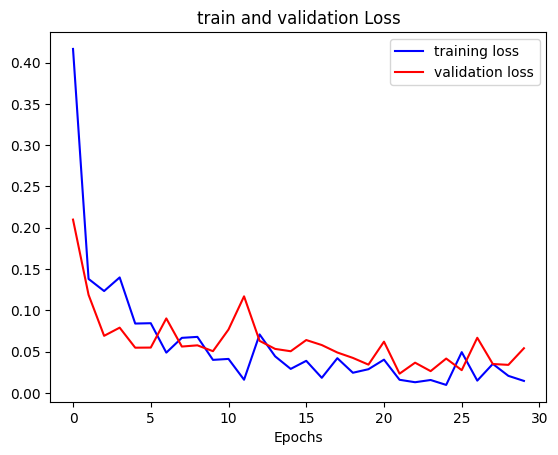

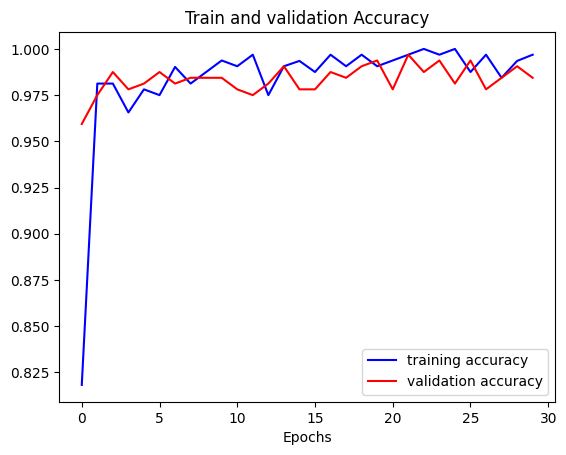

In [ ]:
plot_loss_curves(inception_history)

In [ ]:
inception_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extraction_layer (  (None, 2048)              21802784  
 KerasLayer)                                                     
                                                                 
 output_layer (Dense)        (None, 2)                 4098      
                                                                 
Total params: 21806882 (83.19 MB)
Trainable params: 4098 (16.01 KB)
Non-trainable params: 21802784 (83.17 MB)
_________________________________________________________________


In [ ]:
# Save the InceptionV3 model
tf.keras.models.save_model(inception_model, '/content/drive/MyDrive/tiger_inception_modeltrue.h5')

<ipython-input-15-8dac3125c6a7>:2: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  tf.keras.models.save_model(inception_model, '/content/drive/MyDrive/tiger_inception_modeltrue.h5')


In [5]:
# Load the InceptionV3 model
new_inception_model = tf.keras.models.load_model('/content/drive/MyDrive/tiger_inception_modeltrue.h5',
                                                custom_objects={'KerasLayer': hub.KerasLayer})

33/33 [==============================] - 15s 441ms/step


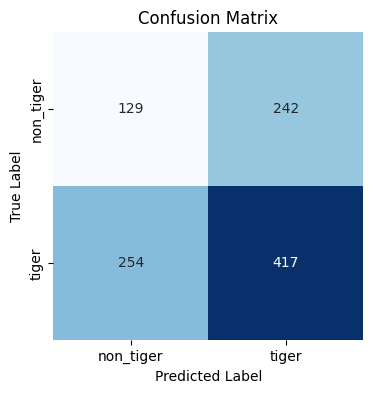

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming y_test and y_pred_classes are your true and predicted labels
# Replace these with your actual data
y_true = test_data.classes
y_pred = new_inception_model.predict(test_data)
# Convert predicted probabilities to class labels using argmax
y_pred_classes = np.argmax(y_pred, axis=1)

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Plot the confusion matrix using seaborn
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False,
            xticklabels=["non_tiger", "tiger"],
            yticklabels=["non_tiger", "tiger"])
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
# Function to preprocess an image for prediction
def preprocess_image_inception(filename, img_shape=299):
    img = tf.io.read_file(filename)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.resize(img, size=[img_shape, img_shape])
    img = tf.image.convert_image_dtype(img, dtype=tf.float32)
    img = tf.expand_dims(img, axis=0)  # Add batch dimension
    return img

In [ ]:
def pred_and_plot_inception(model, filename, class_names):
    img = preprocess_image_inception(filename)
    pred = model.predict(img)
    pred_class = class_names[int(tf.round(pred)[0][0])]

    # Load the original image
    original_img = cv2.imread(filename)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

    # Plot the original image
    plt.imshow(original_img)
    plt.title(f"Prediction: {pred_class}")
    plt.axis(False)
    plt.show()

In [ ]:
data_dir = pathlib.Path("/content/drive/MyDrive/dataset_tiger/train") # turn our training path into a Python path
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectories
print(class_names)

['non_tiger' 'tiger']


In [ ]:
class_names = ['non_tiger','tiger']

1/1 [==============================] - 5s 5s/step


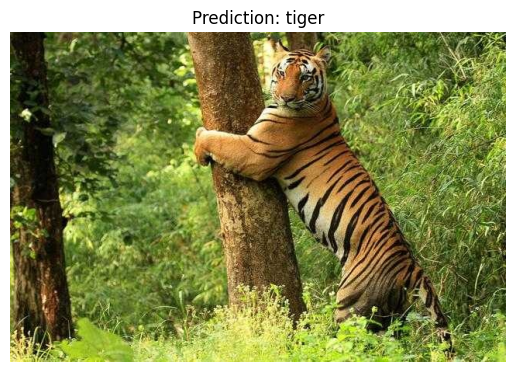

In [ ]:
pred_and_plot_inception(new_inception_model, "/content/drive/MyDrive/dataset_tiger/test/tiger/0B9ZACRC3ZOP.jpg", class_names)

1/1 [==============================] - 0s 49ms/step


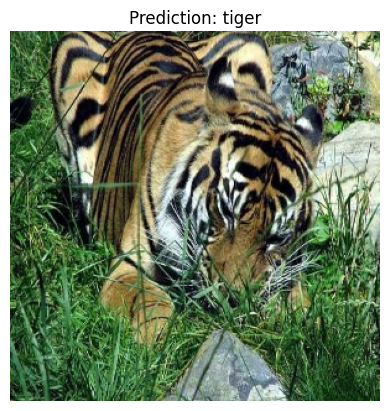

In [ ]:
pred_and_plot(new_inception_model, "/content/drive/MyDrive/dataset_tiger/test/tiger/36JG5ZMKXQDV.jpg", class_names)

1/1 [==============================] - 0s 137ms/step


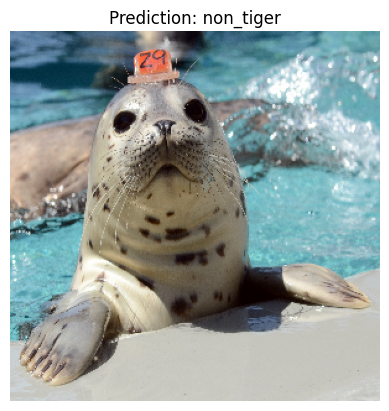

In [ ]:
pred_and_plot(new_inception_model, "/content/drive/MyDrive/dataset_tiger/train/non_tiger/008f8f926e.jpg", class_names)

1/1 [==============================] - 0s 43ms/step


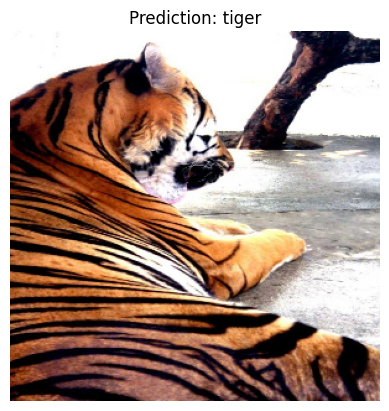

In [ ]:
pred_and_plot(new_inception_model, "/content/drive/MyDrive/dataset_tiger/test/tiger/6QVMZJXM3ICR.jpg", class_names)

1/1 [==============================] - 0s 46ms/step


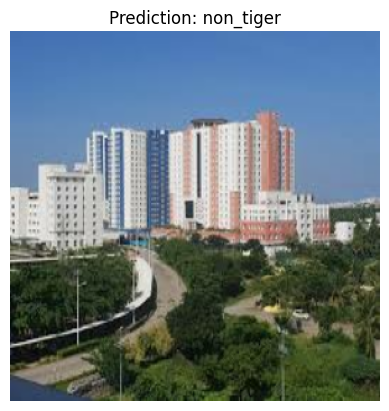

In [ ]:
pred_and_plot(new_inception_model, "/content/drive/MyDrive/vit image.jpeg", class_names)

1/1 [==============================] - 0s 173ms/step


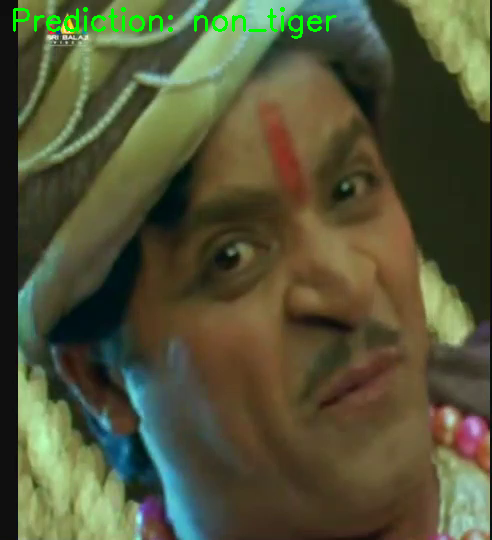

1/1 [==============================] - 0s 43ms/step


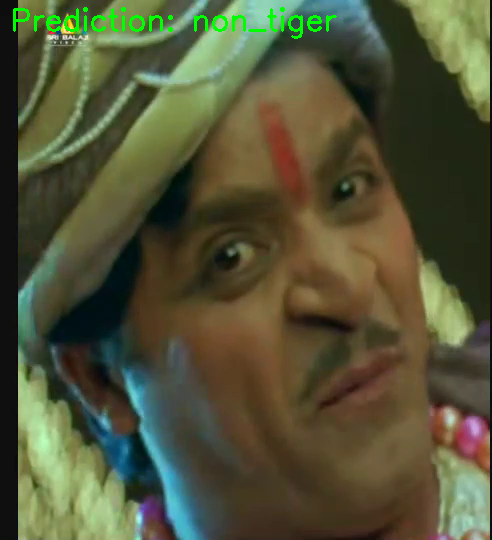

1/1 [==============================] - 0s 50ms/step


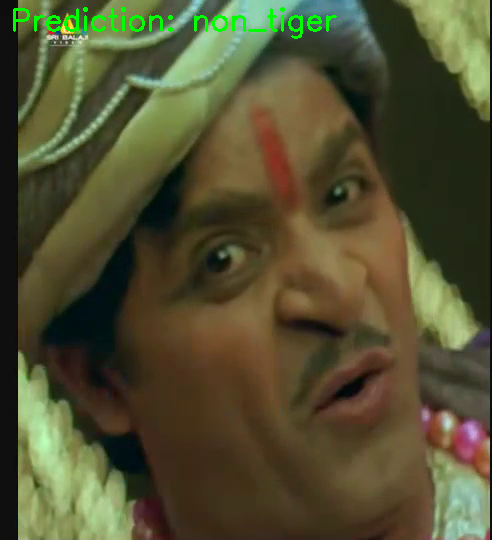

1/1 [==============================] - 0s 45ms/step


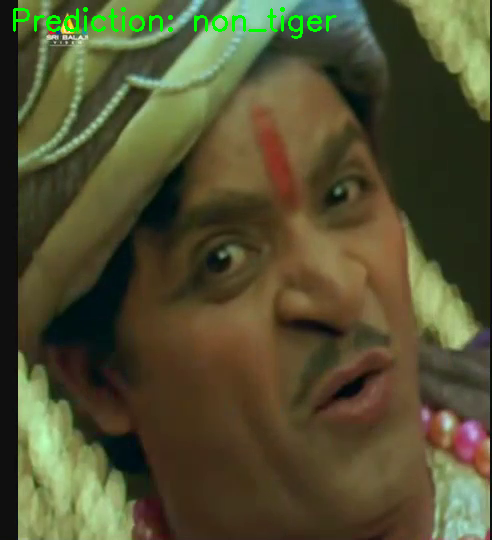

1/1 [==============================] - 0s 42ms/step


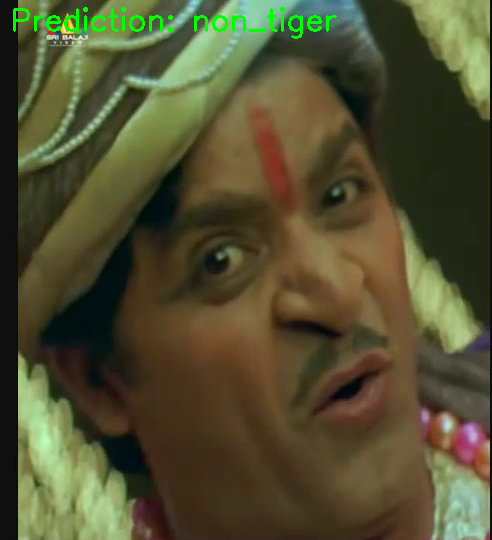

1/1 [==============================] - 0s 44ms/step


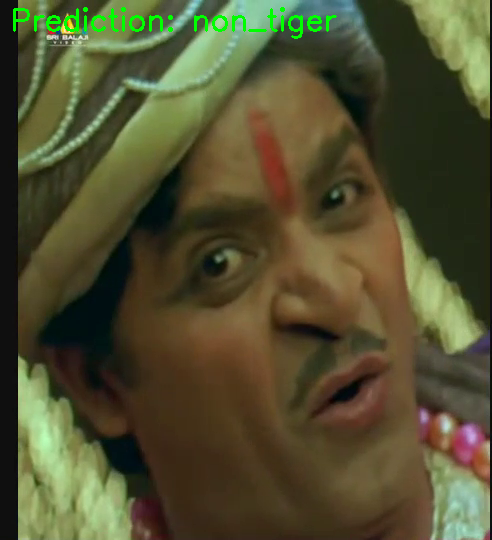

1/1 [==============================] - 0s 41ms/step


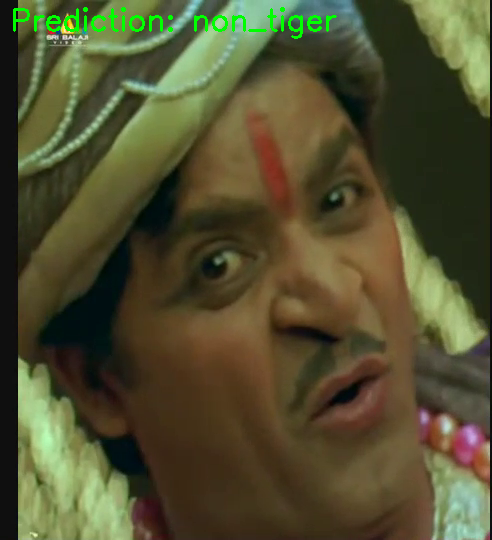

1/1 [==============================] - 0s 46ms/step


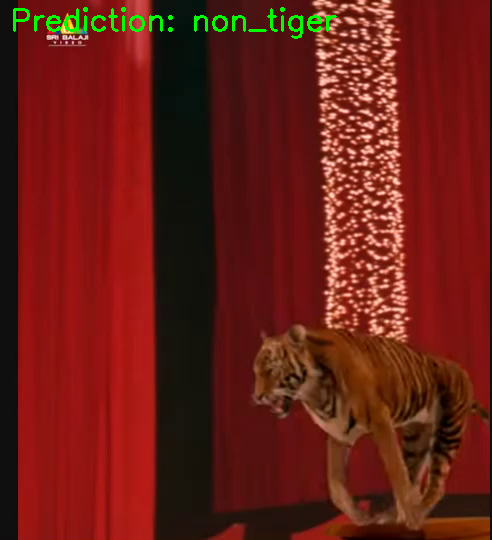

1/1 [==============================] - 0s 50ms/step


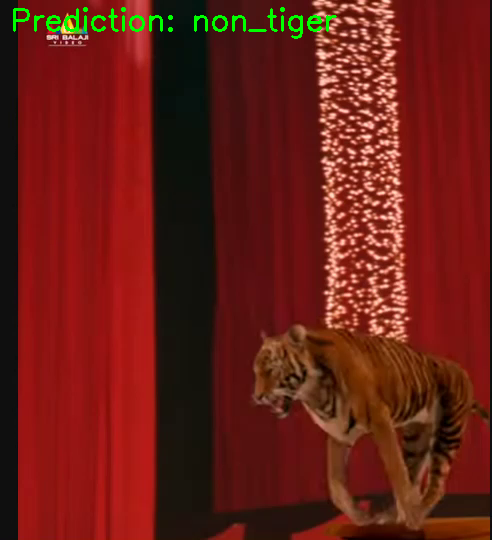

1/1 [==============================] - 0s 60ms/step


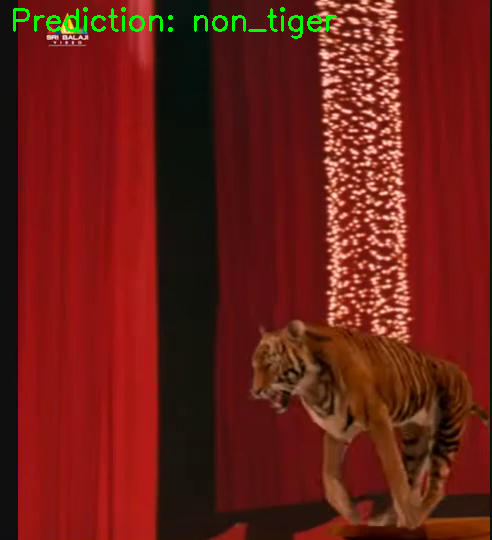

1/1 [==============================] - 0s 40ms/step


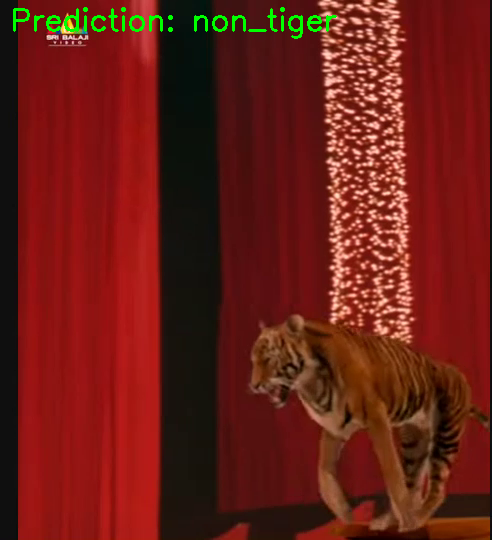

1/1 [==============================] - 0s 63ms/step


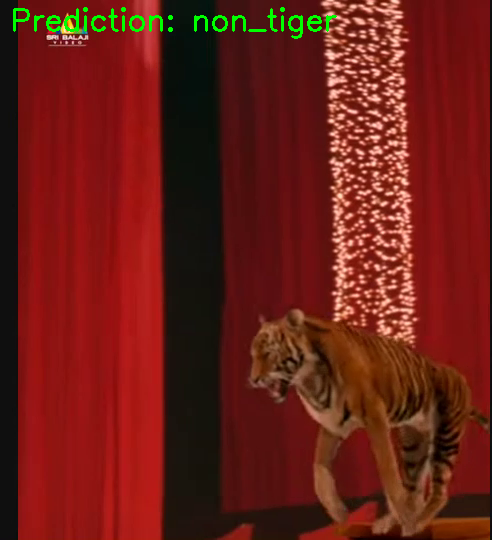

1/1 [==============================] - 0s 39ms/step


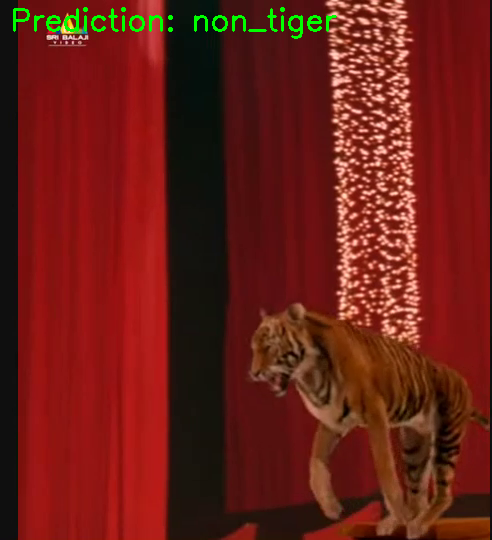

1/1 [==============================] - 0s 67ms/step


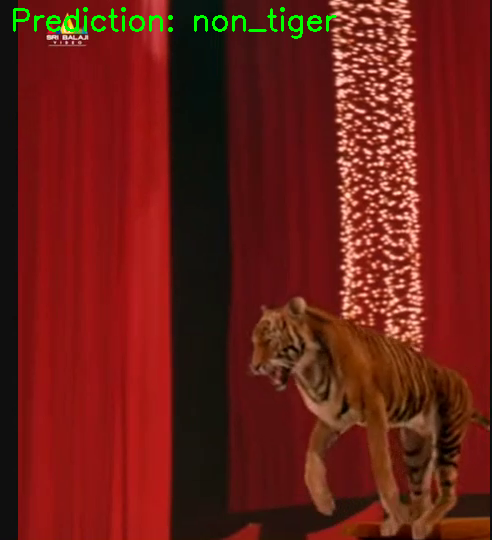

1/1 [==============================] - 0s 41ms/step


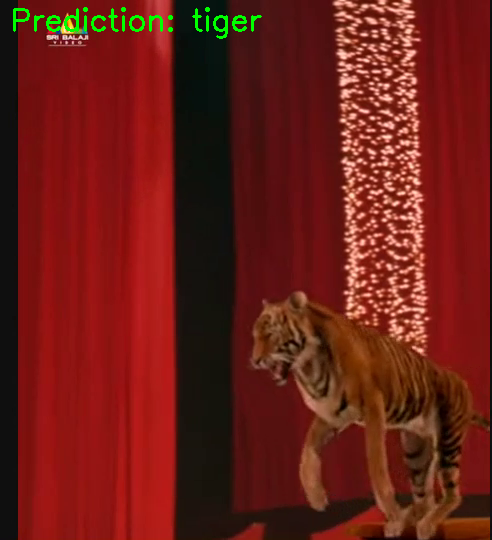

1/1 [==============================] - 0s 40ms/step


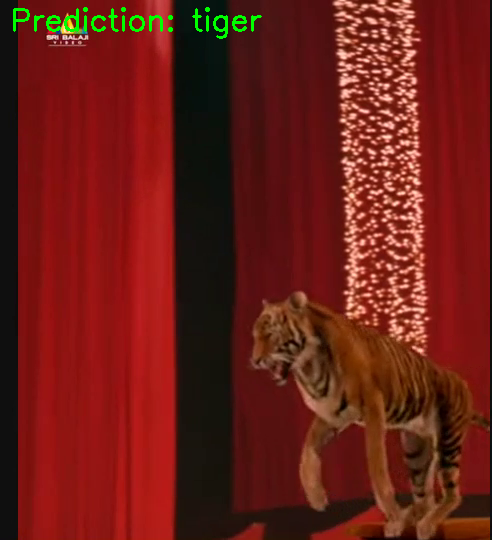

1/1 [==============================] - 0s 53ms/step


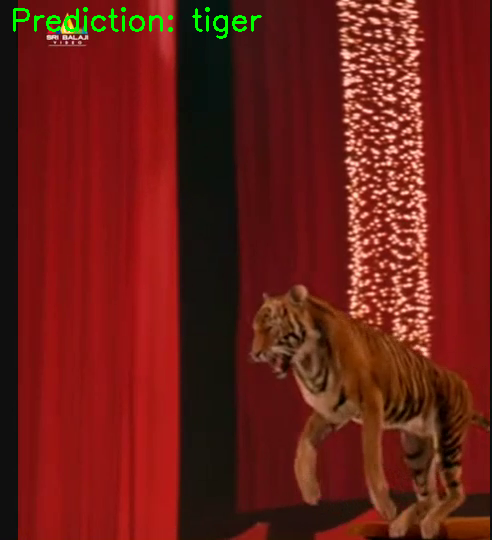

1/1 [==============================] - 0s 63ms/step


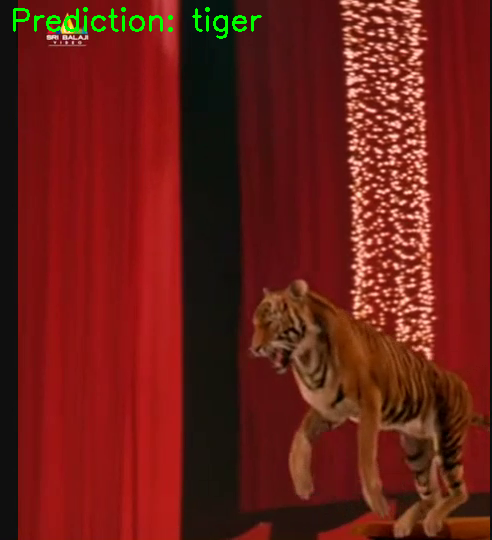

1/1 [==============================] - 0s 60ms/step


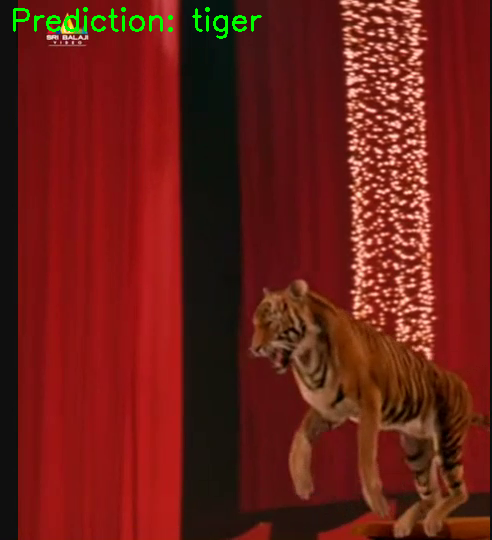

1/1 [==============================] - 0s 66ms/step


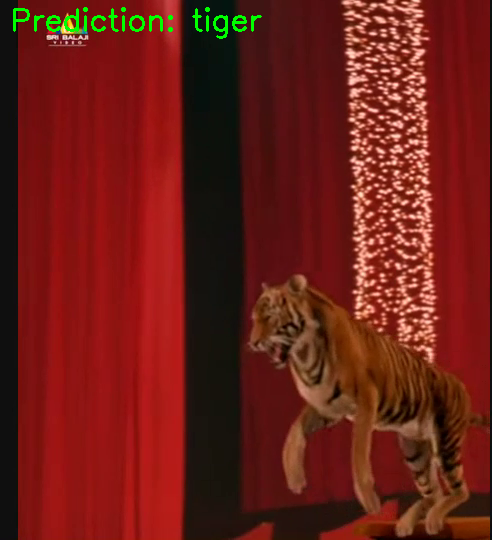

1/1 [==============================] - 0s 69ms/step


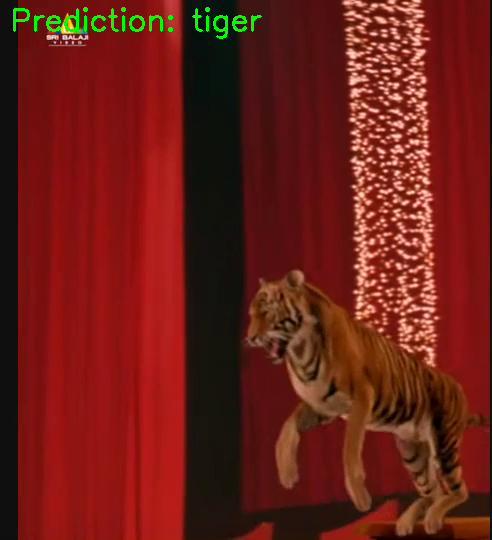

1/1 [==============================] - 0s 54ms/step


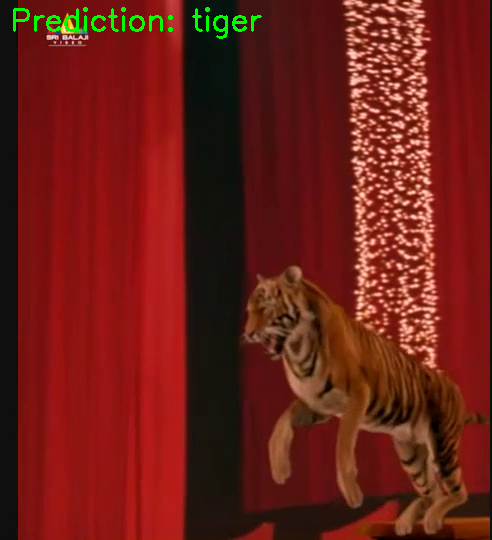

1/1 [==============================] - 0s 59ms/step


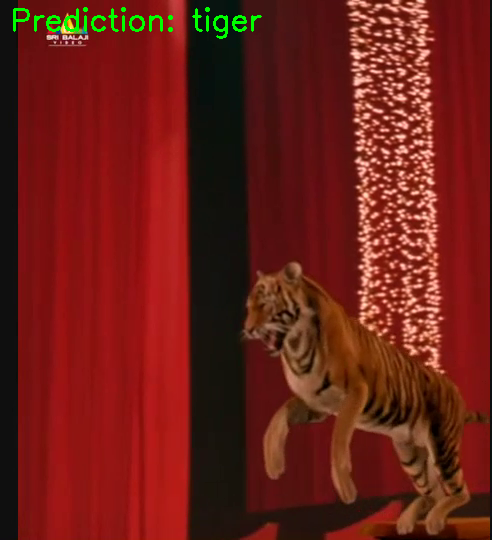

1/1 [==============================] - 0s 80ms/step


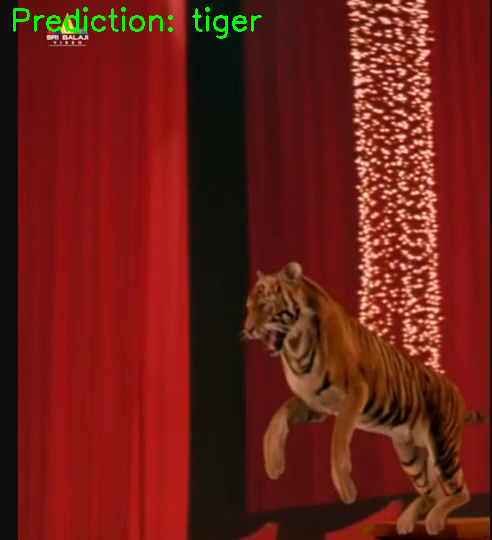

1/1 [==============================] - 0s 36ms/step


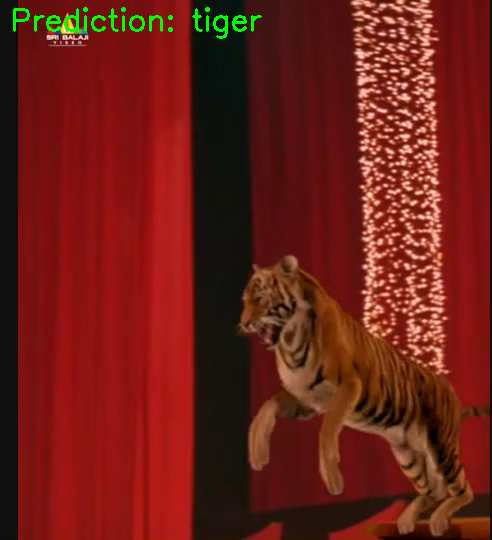

1/1 [==============================] - 0s 61ms/step


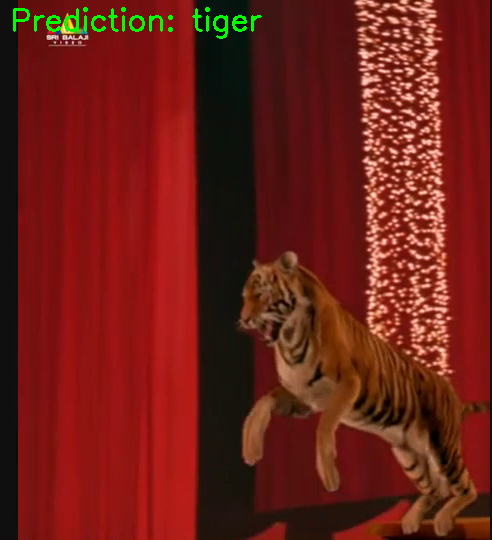

1/1 [==============================] - 0s 38ms/step


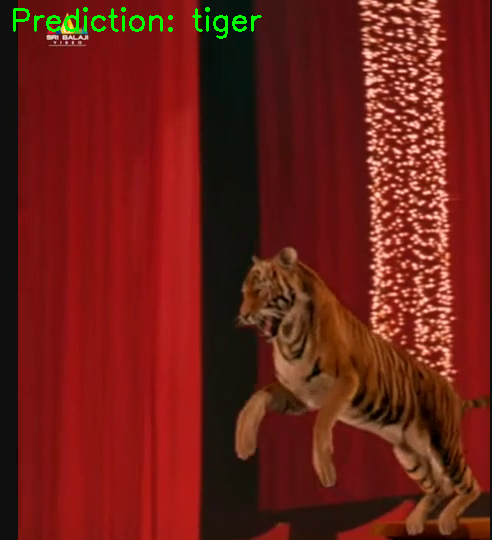

1/1 [==============================] - 0s 41ms/step


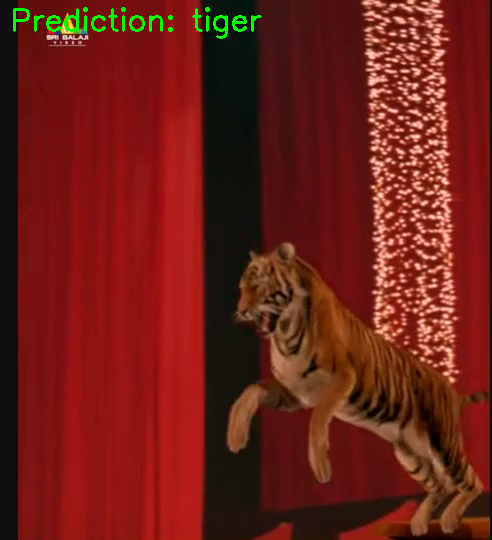

1/1 [==============================] - 0s 48ms/step


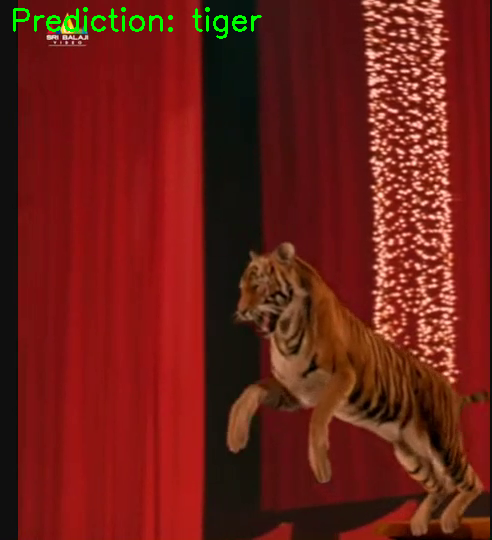

1/1 [==============================] - 0s 46ms/step


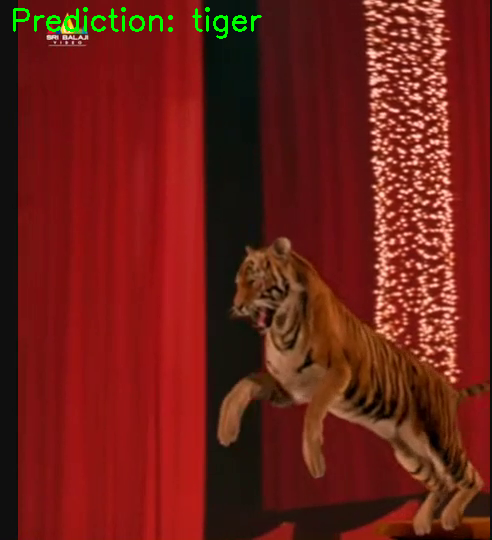

1/1 [==============================] - 0s 42ms/step


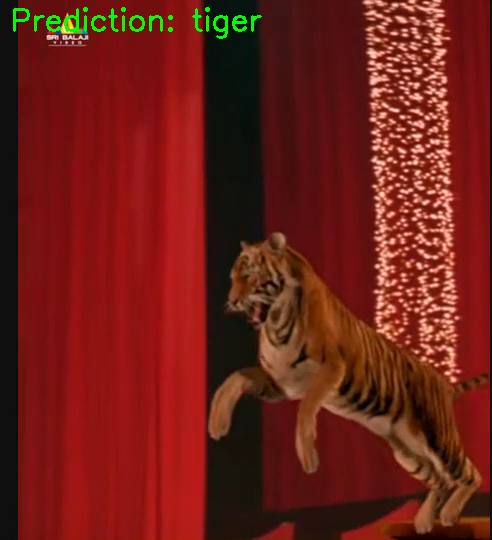

1/1 [==============================] - 0s 39ms/step


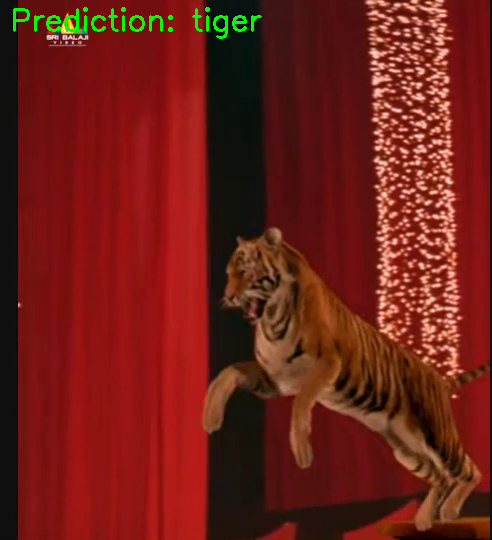

1/1 [==============================] - 0s 58ms/step


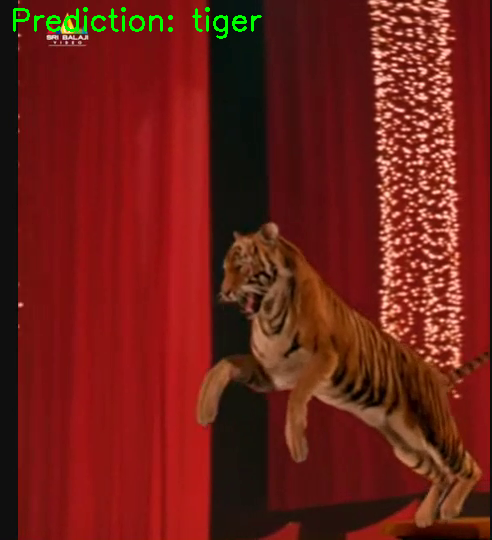

1/1 [==============================] - 0s 47ms/step


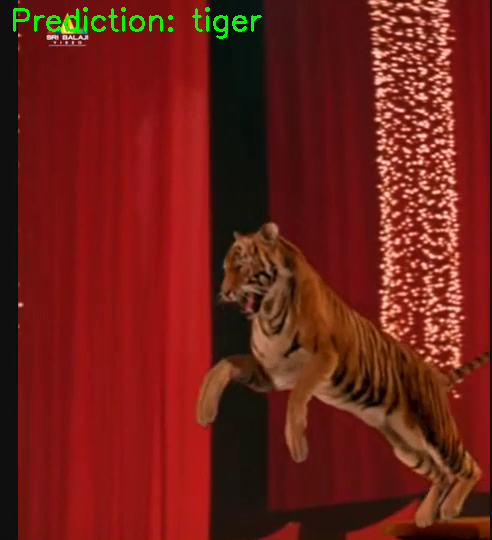

1/1 [==============================] - 0s 48ms/step


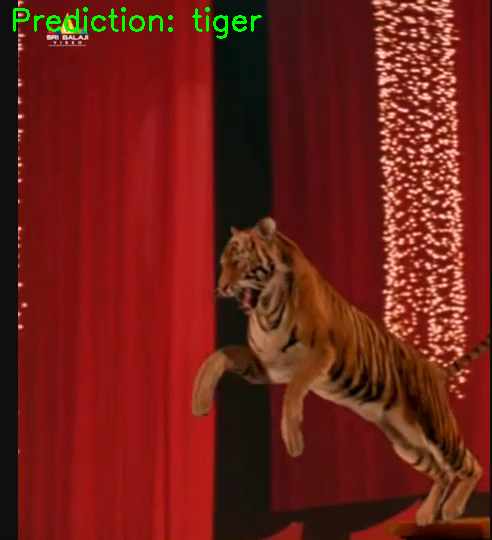

1/1 [==============================] - 0s 63ms/step


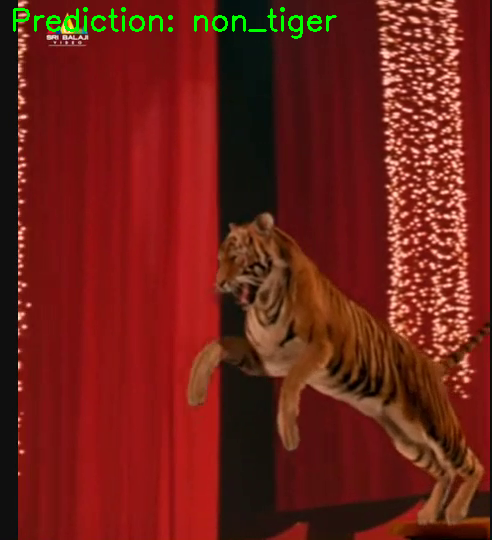

1/1 [==============================] - 0s 48ms/step


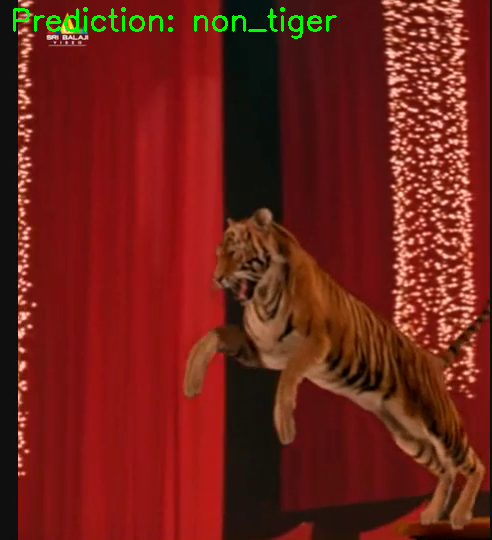

1/1 [==============================] - 0s 40ms/step


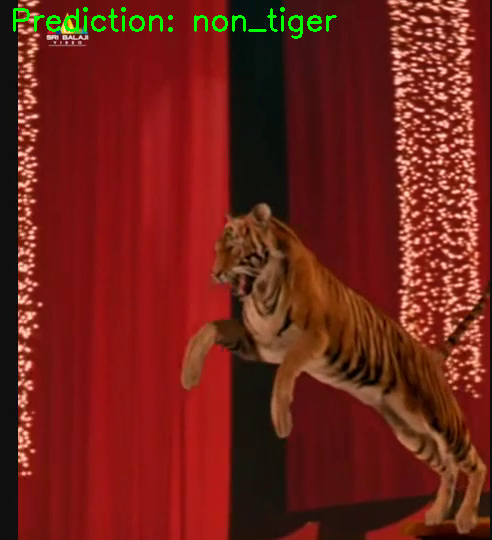

1/1 [==============================] - 0s 59ms/step


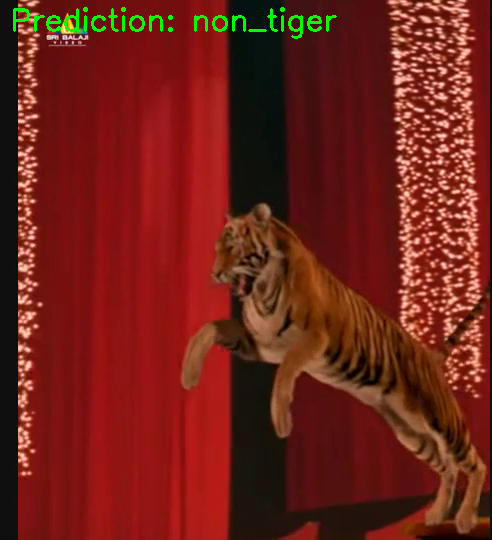

1/1 [==============================] - 0s 63ms/step


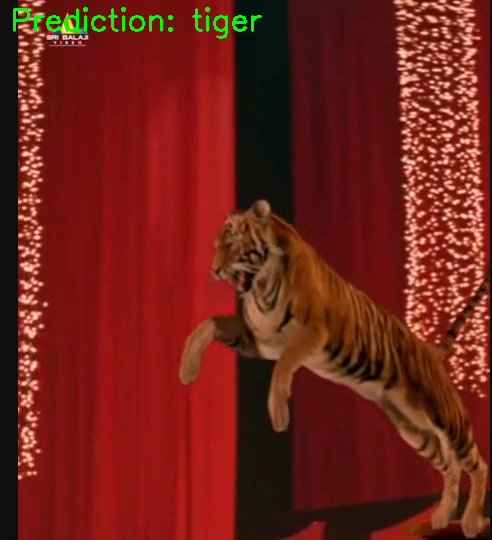

1/1 [==============================] - 0s 38ms/step


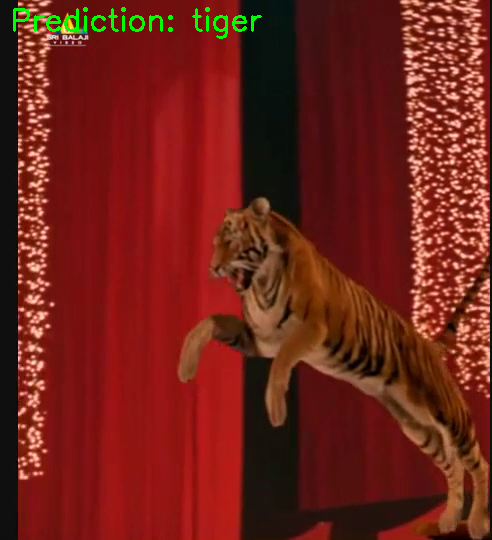

1/1 [==============================] - 0s 36ms/step


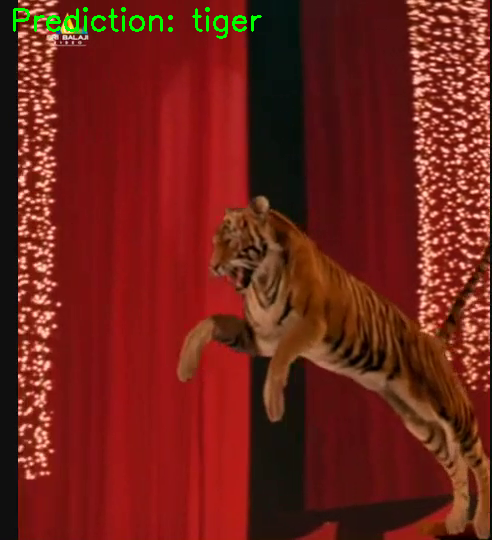

1/1 [==============================] - 0s 39ms/step


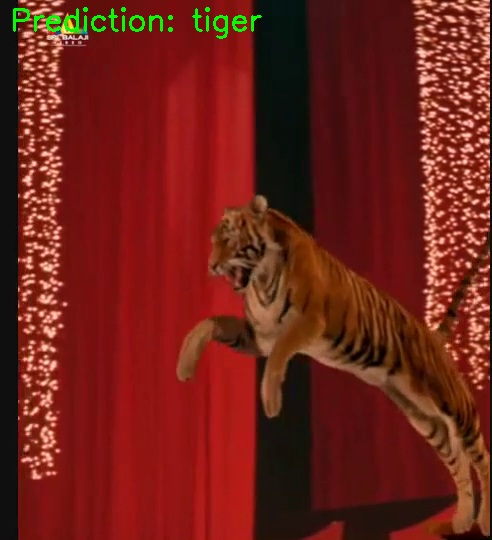

1/1 [==============================] - 0s 37ms/step


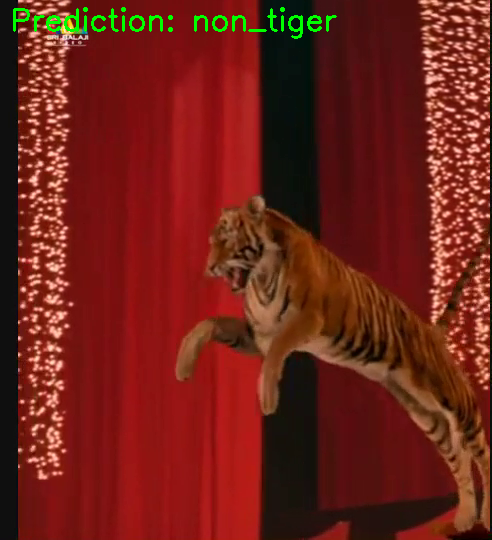

1/1 [==============================] - 0s 38ms/step


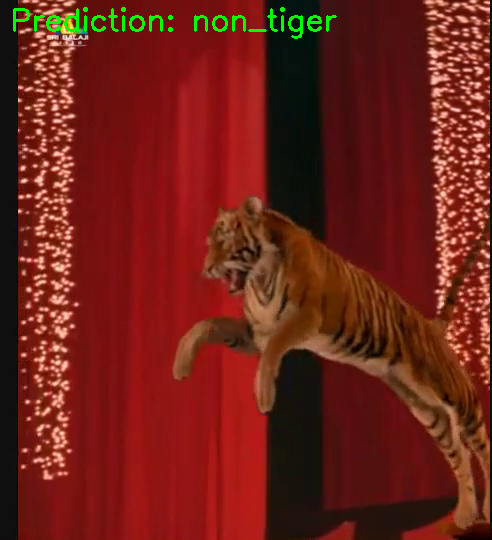

1/1 [==============================] - 0s 38ms/step


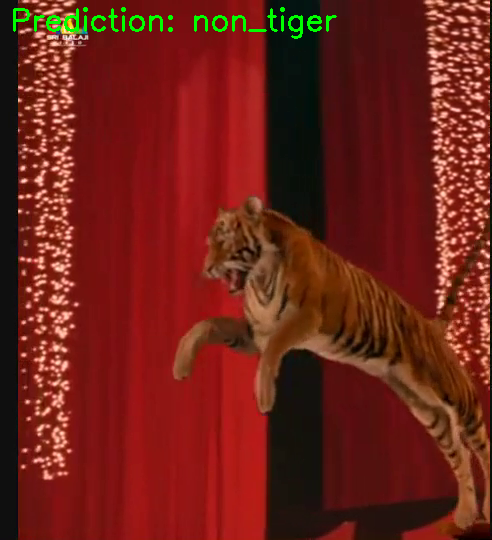

1/1 [==============================] - 0s 37ms/step


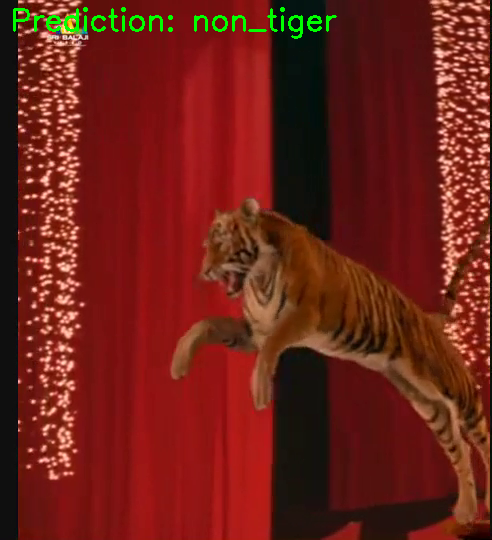

1/1 [==============================] - 0s 39ms/step


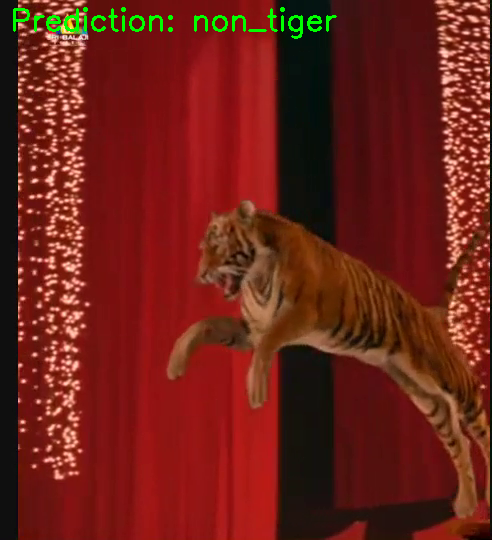

1/1 [==============================] - 0s 36ms/step


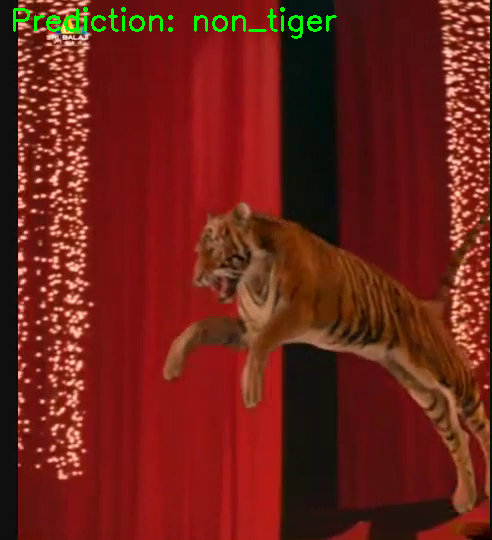

1/1 [==============================] - 0s 38ms/step


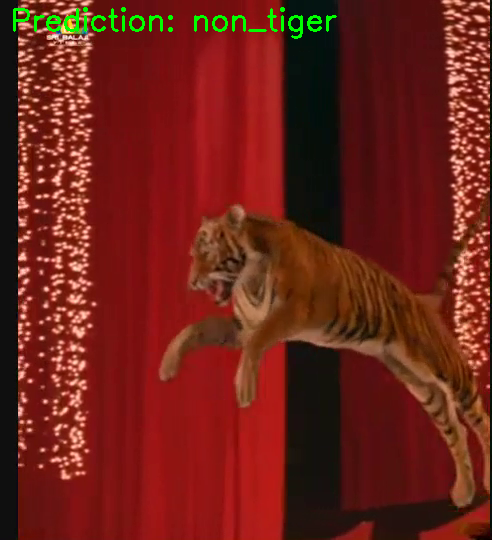

1/1 [==============================] - 0s 38ms/step


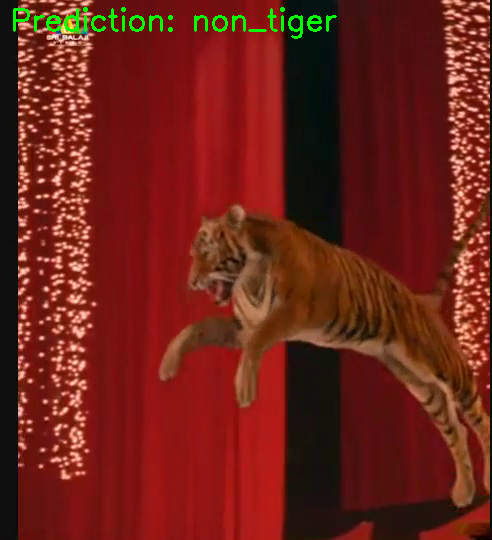

1/1 [==============================] - 0s 39ms/step


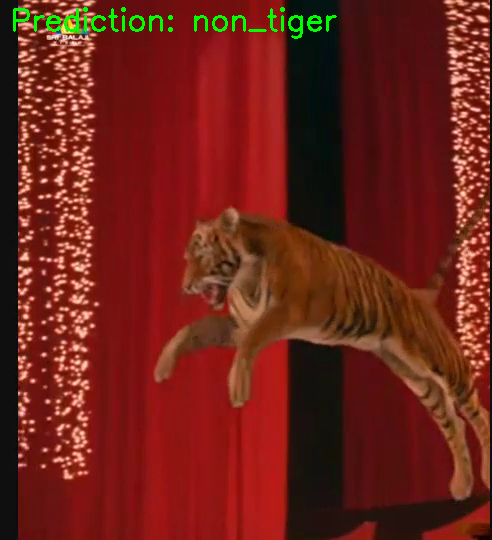

1/1 [==============================] - 0s 40ms/step


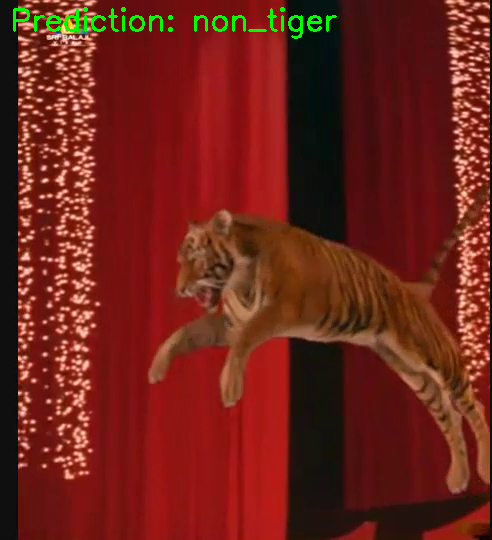

1/1 [==============================] - 0s 39ms/step


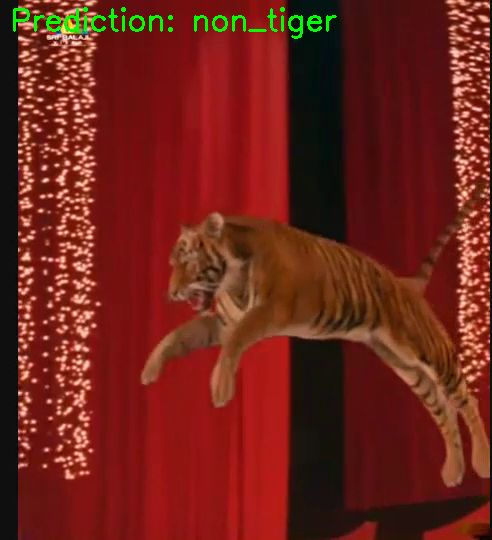

1/1 [==============================] - 0s 43ms/step


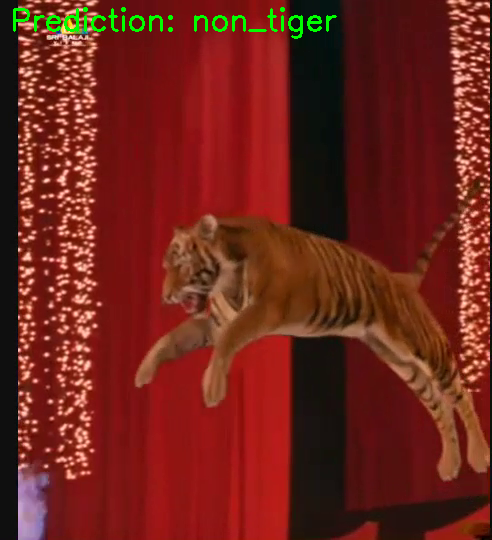

1/1 [==============================] - 0s 35ms/step


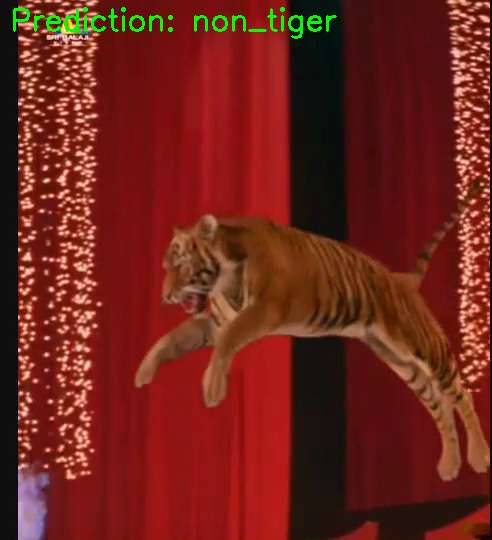

1/1 [==============================] - 0s 47ms/step


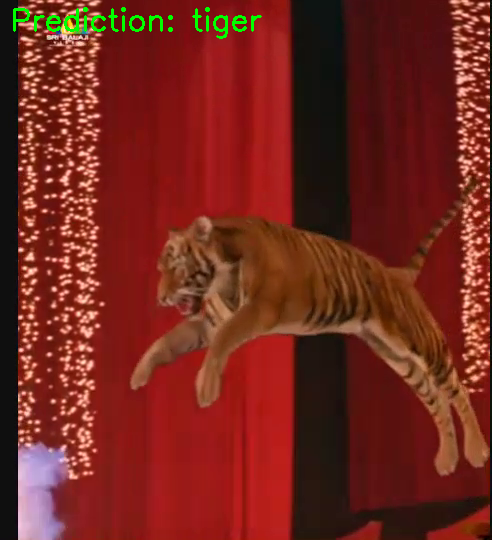

1/1 [==============================] - 0s 56ms/step


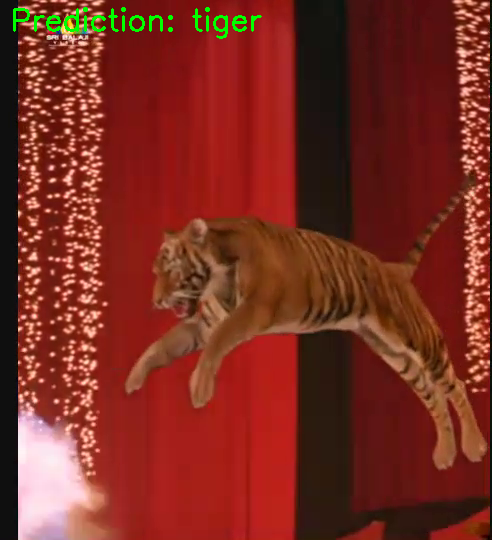

1/1 [==============================] - 0s 52ms/step


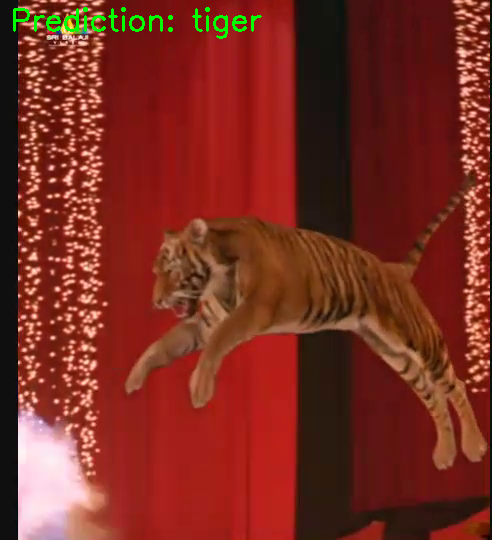

1/1 [==============================] - 0s 40ms/step


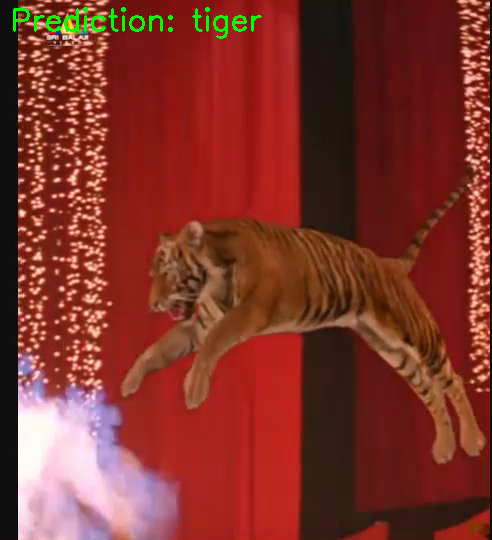

1/1 [==============================] - 0s 38ms/step


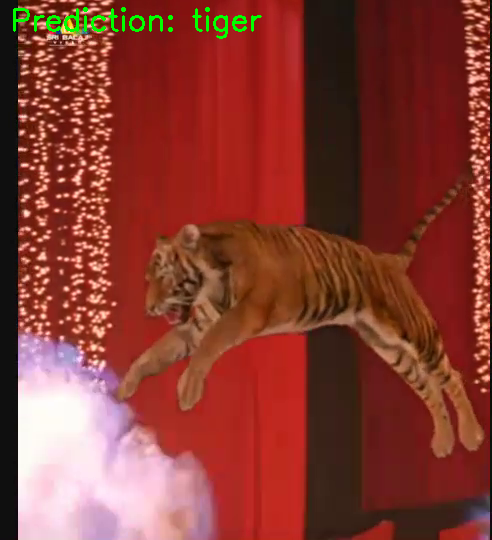

1/1 [==============================] - 0s 37ms/step


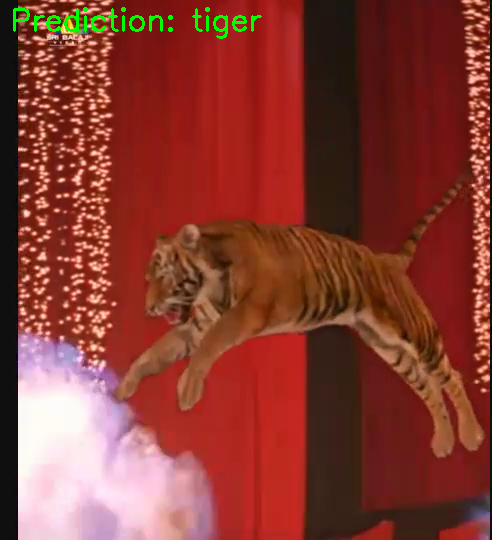

1/1 [==============================] - 0s 35ms/step


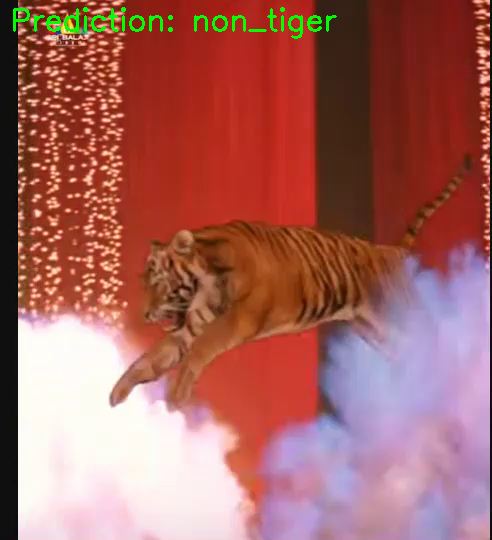

1/1 [==============================] - 0s 42ms/step


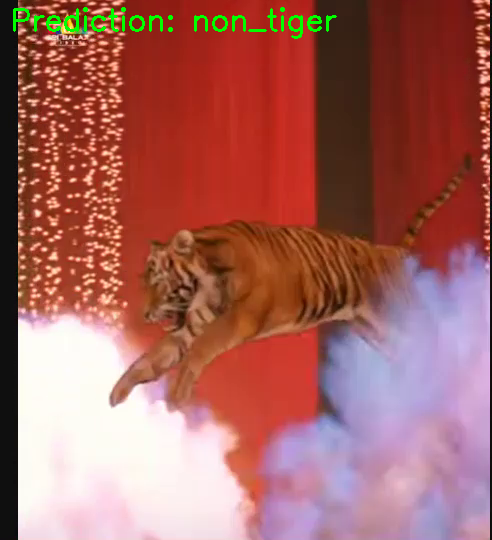

1/1 [==============================] - 0s 40ms/step


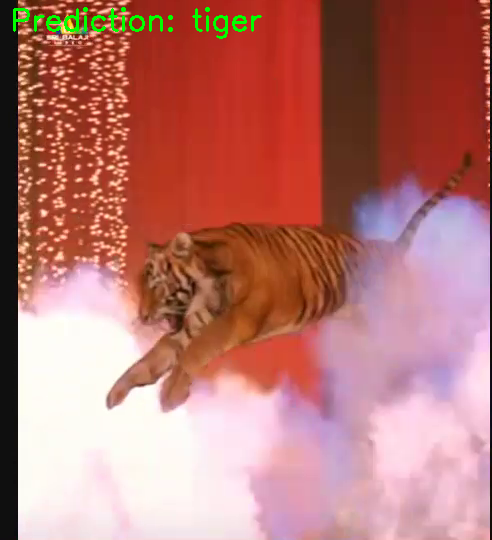

1/1 [==============================] - 0s 38ms/step


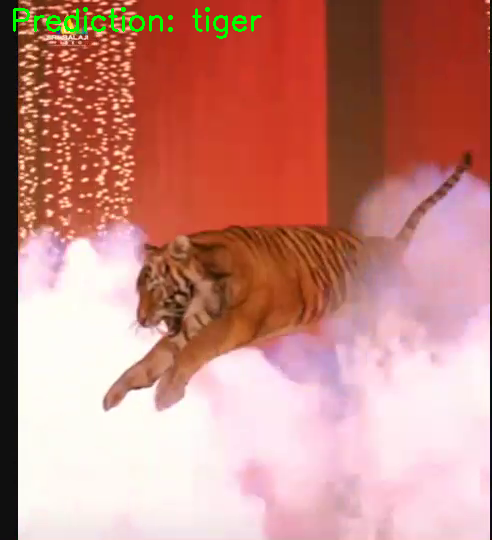

1/1 [==============================] - 0s 37ms/step


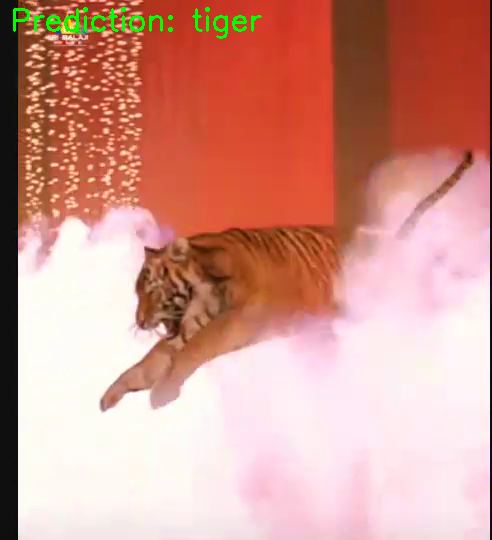

1/1 [==============================] - 0s 40ms/step


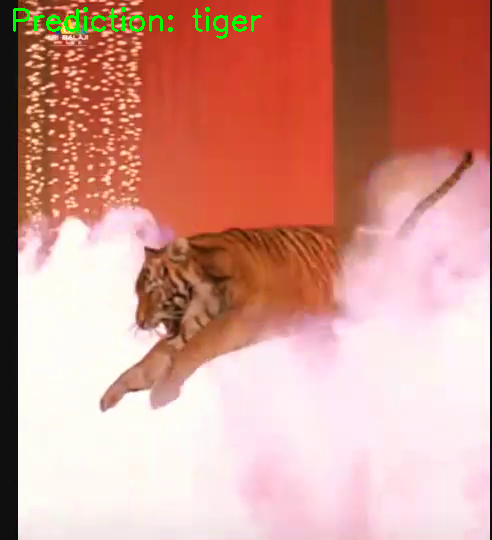

1/1 [==============================] - 0s 48ms/step


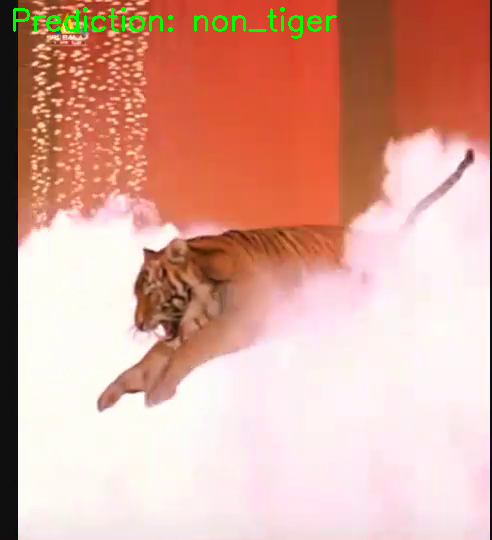

1/1 [==============================] - 0s 39ms/step


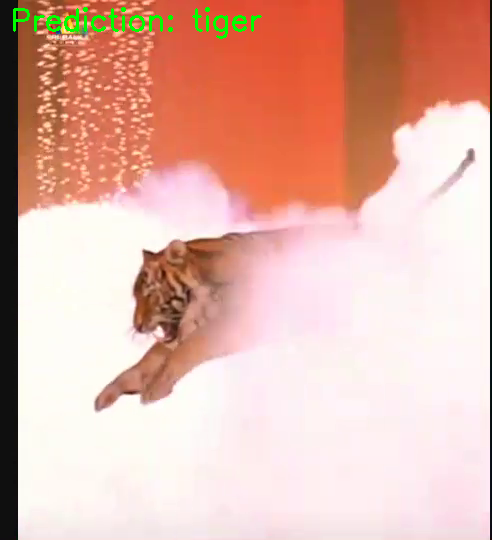

1/1 [==============================] - 0s 35ms/step


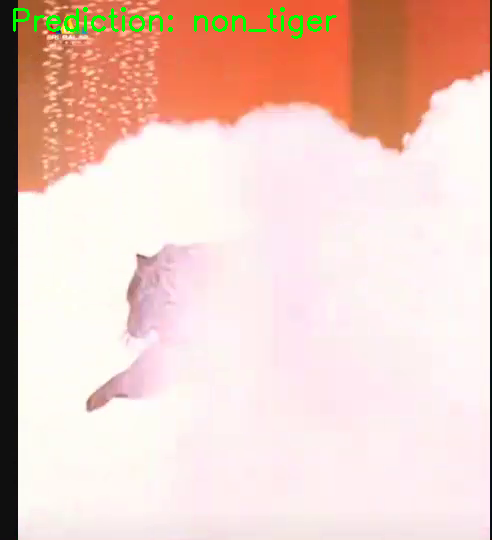

1/1 [==============================] - 0s 36ms/step


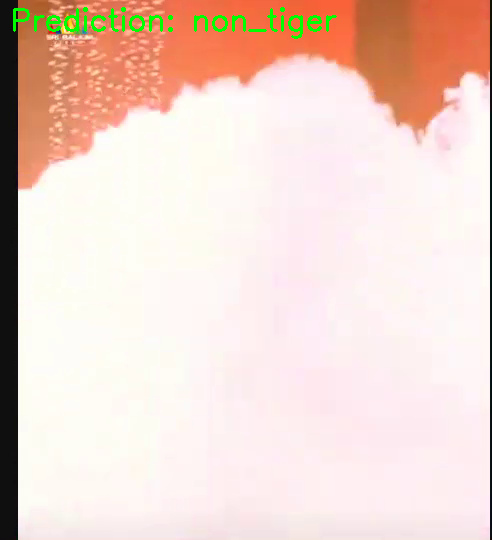

1/1 [==============================] - 0s 54ms/step


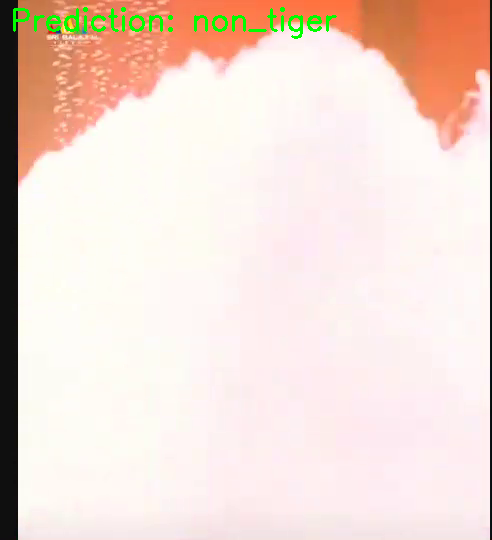

1/1 [==============================] - 0s 37ms/step


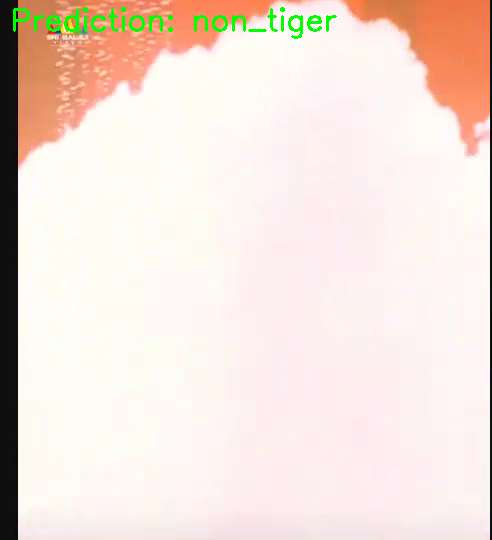

1/1 [==============================] - 0s 46ms/step


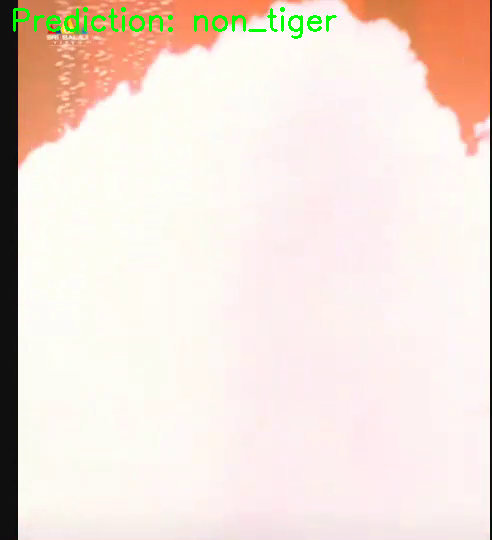

1/1 [==============================] - 0s 38ms/step


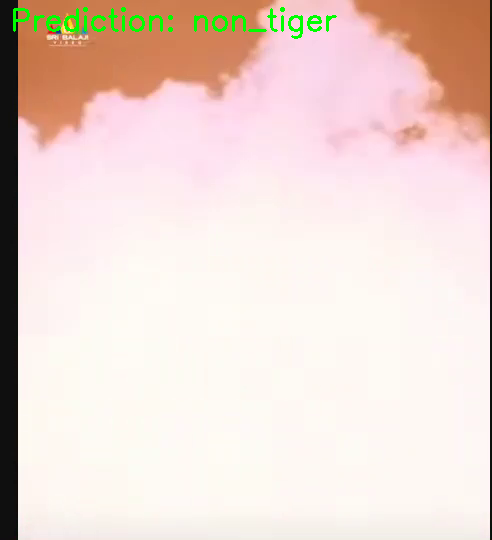

1/1 [==============================] - 0s 37ms/step


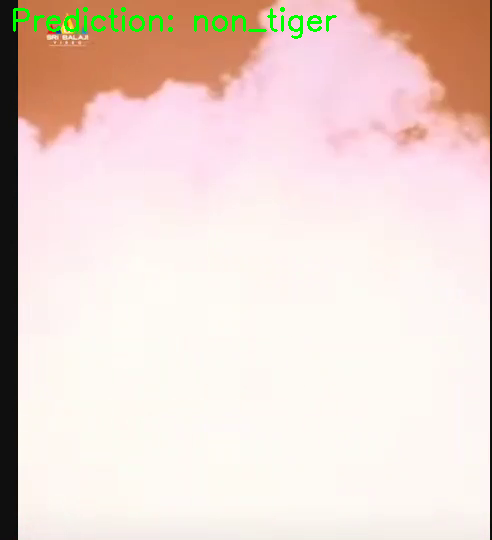

1/1 [==============================] - 0s 47ms/step


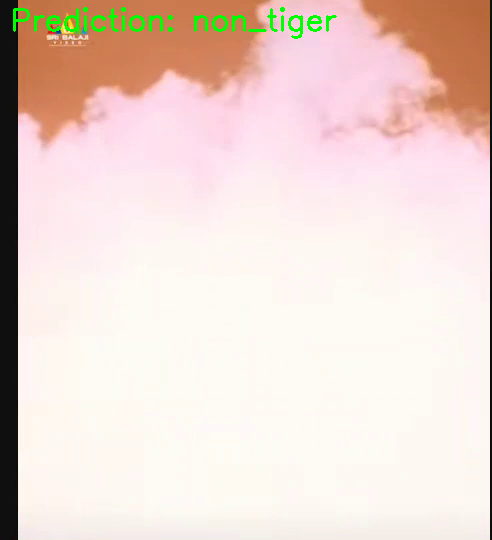

1/1 [==============================] - 0s 35ms/step


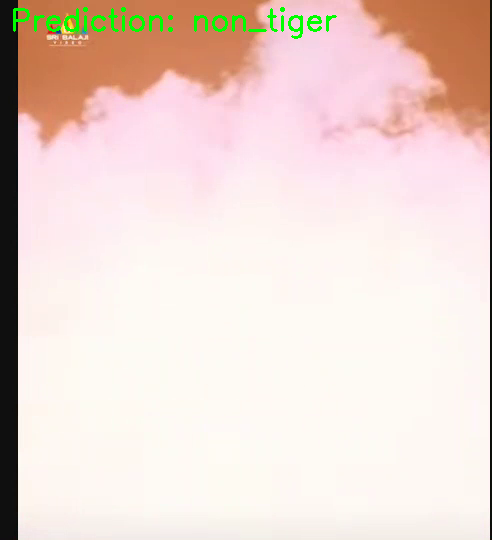

1/1 [==============================] - 0s 39ms/step


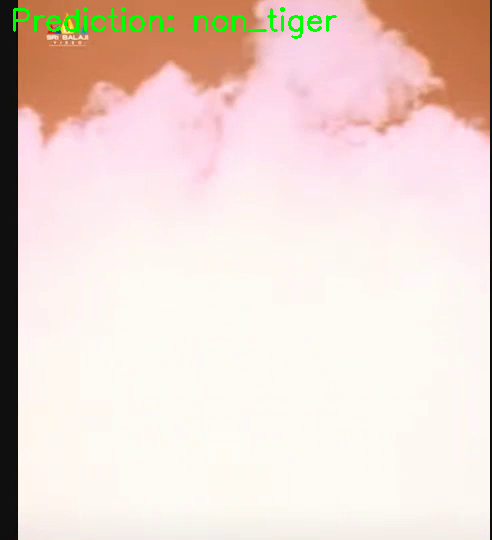

1/1 [==============================] - 0s 49ms/step


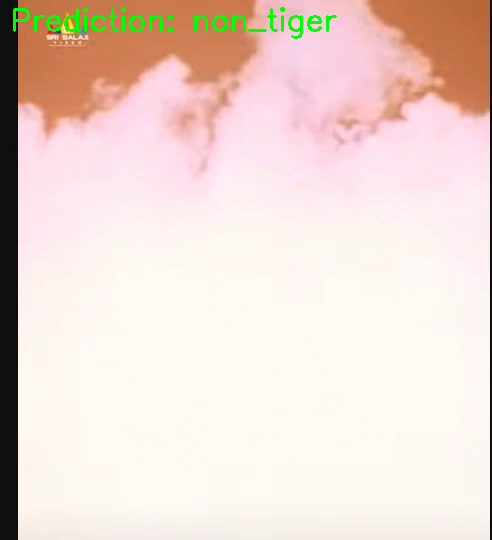

1/1 [==============================] - 0s 39ms/step


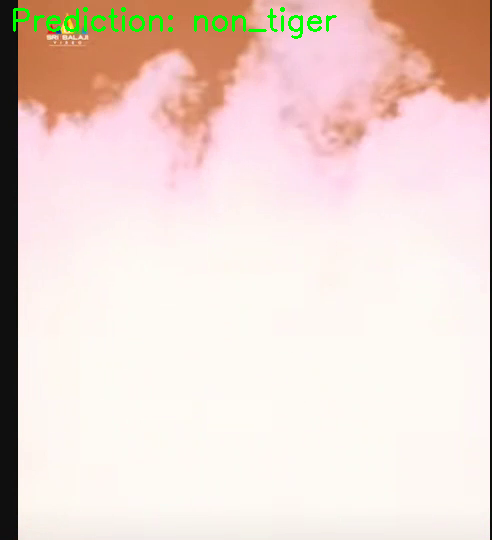

1/1 [==============================] - 0s 37ms/step


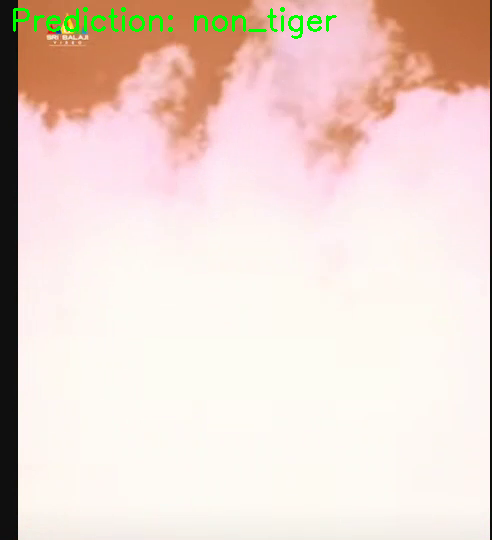

1/1 [==============================] - 0s 39ms/step


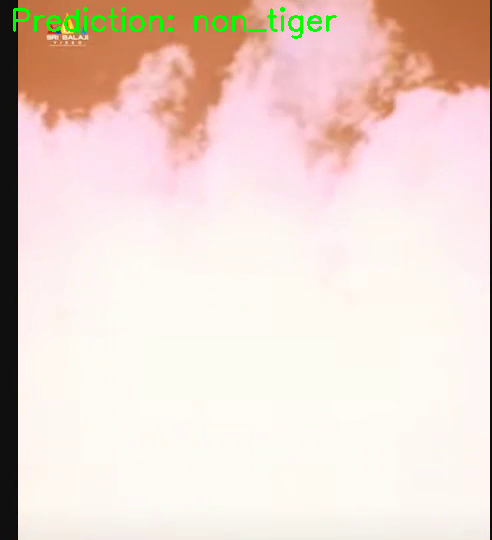

1/1 [==============================] - 0s 36ms/step


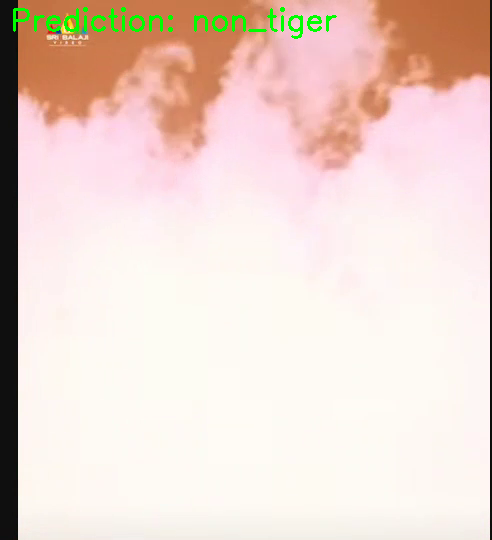

1/1 [==============================] - 0s 37ms/step


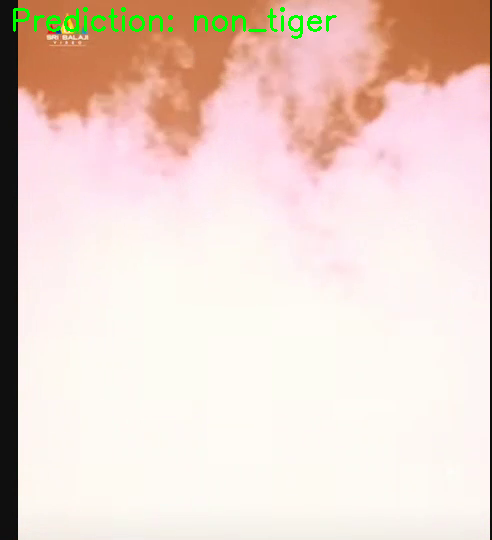

1/1 [==============================] - 0s 41ms/step


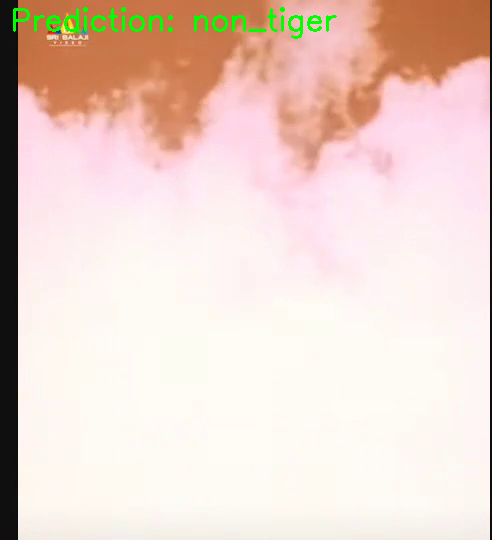

1/1 [==============================] - 0s 47ms/step


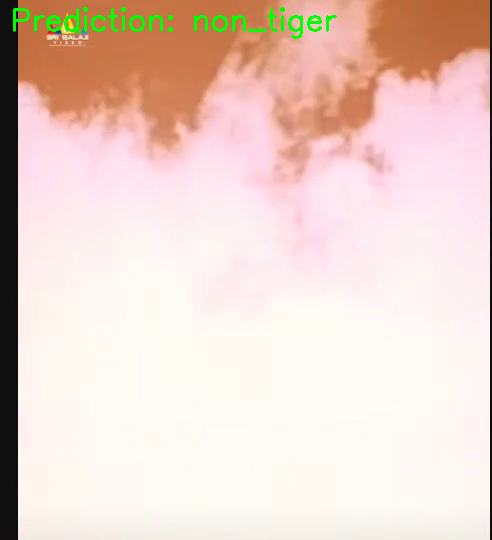

1/1 [==============================] - 0s 54ms/step


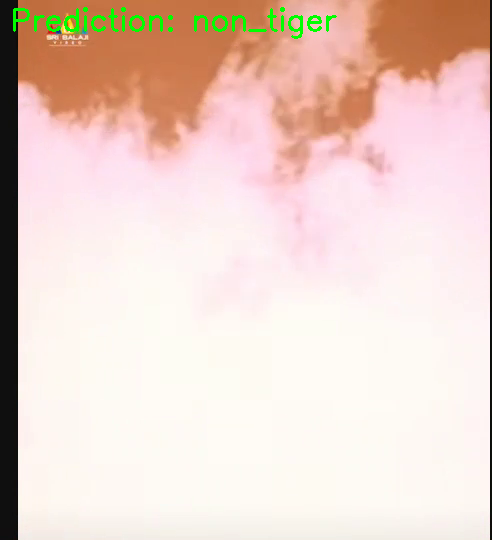

1/1 [==============================] - 0s 37ms/step


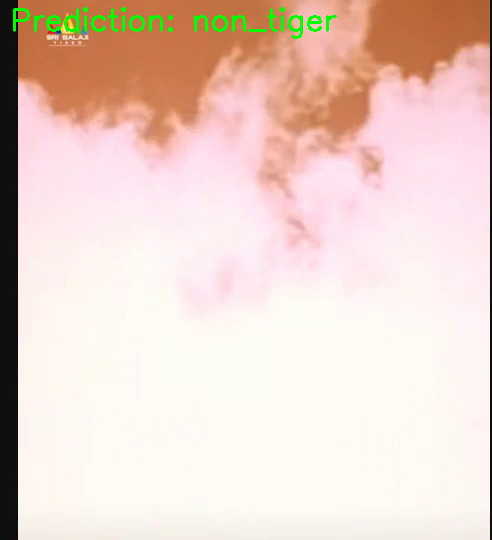

1/1 [==============================] - 0s 92ms/step


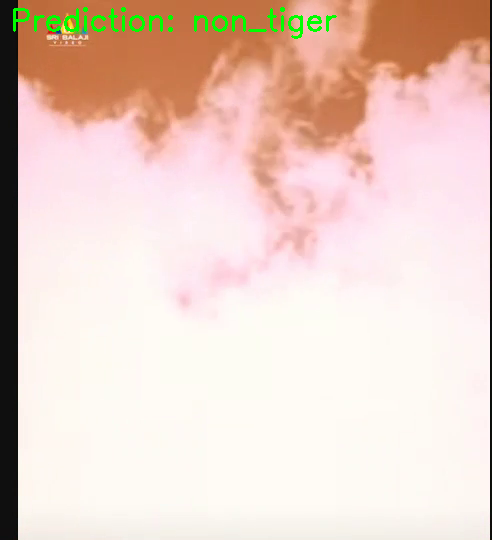

1/1 [==============================] - 0s 60ms/step


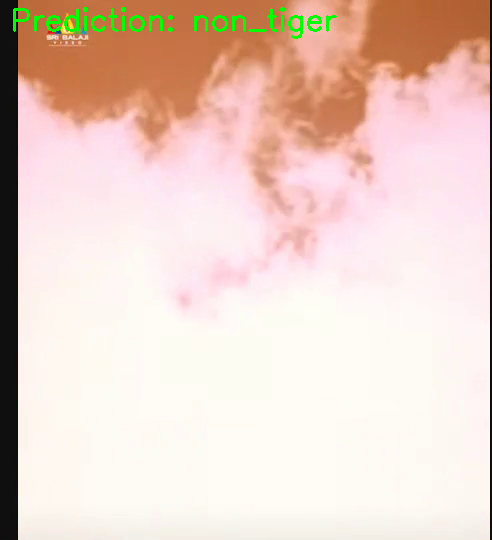

1/1 [==============================] - 0s 58ms/step


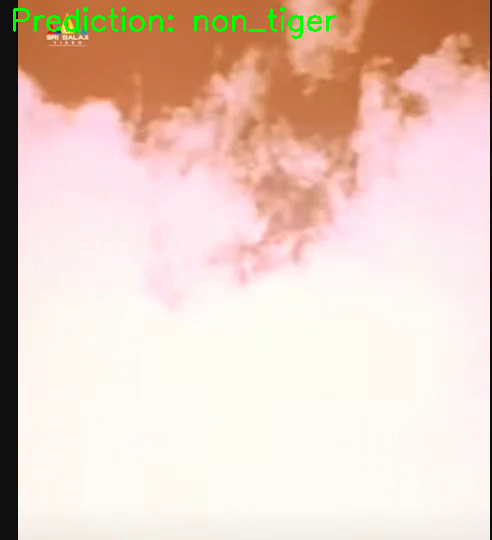

1/1 [==============================] - 0s 57ms/step


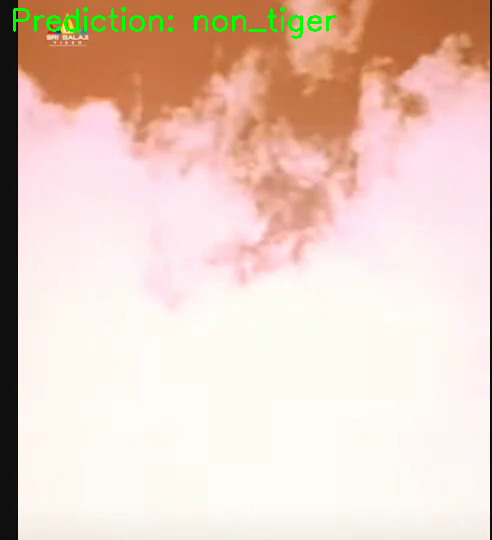

1/1 [==============================] - 0s 77ms/step


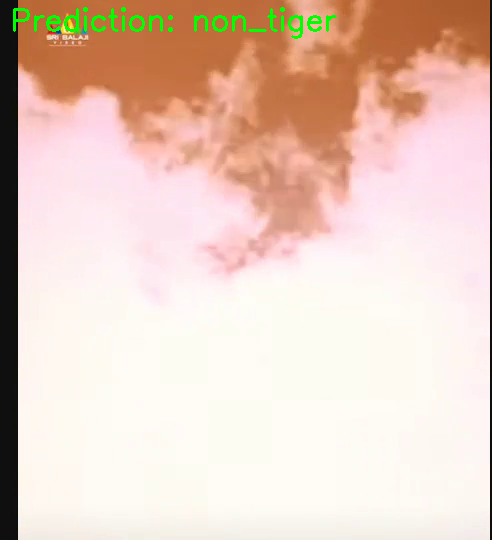

1/1 [==============================] - 0s 58ms/step


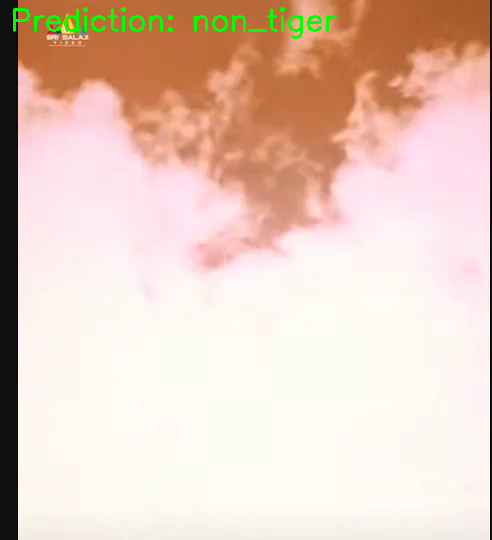

1/1 [==============================] - 0s 52ms/step


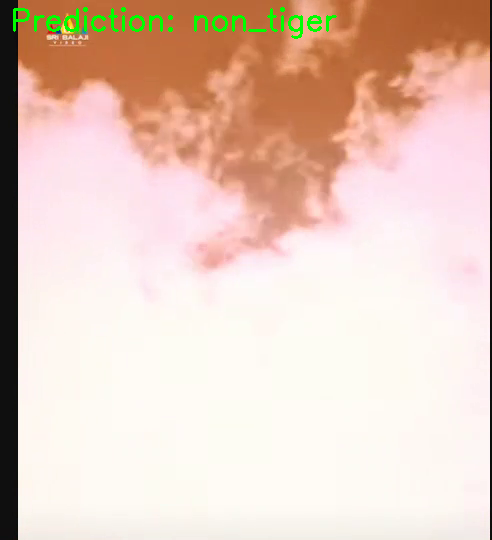

1/1 [==============================] - 0s 61ms/step


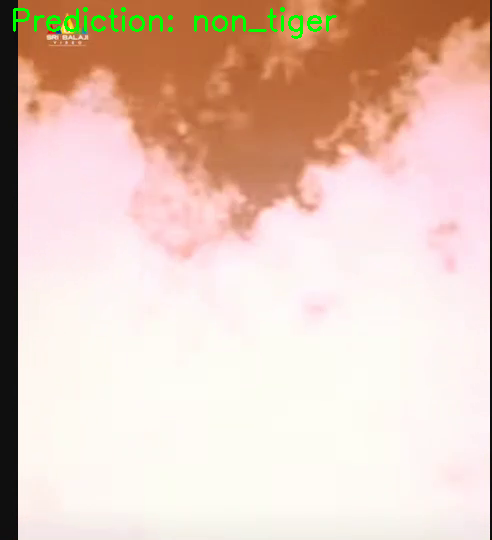

1/1 [==============================] - 0s 55ms/step


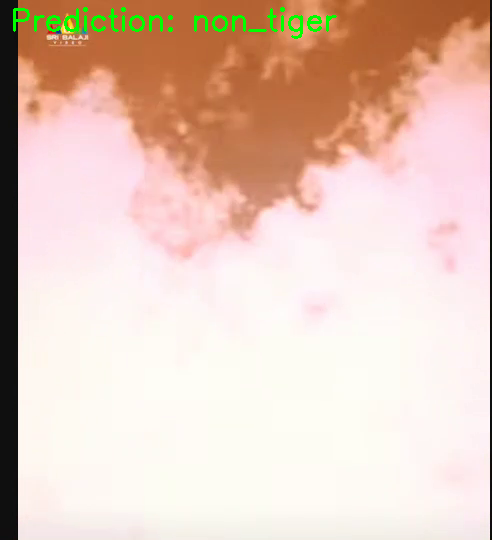

1/1 [==============================] - 0s 61ms/step


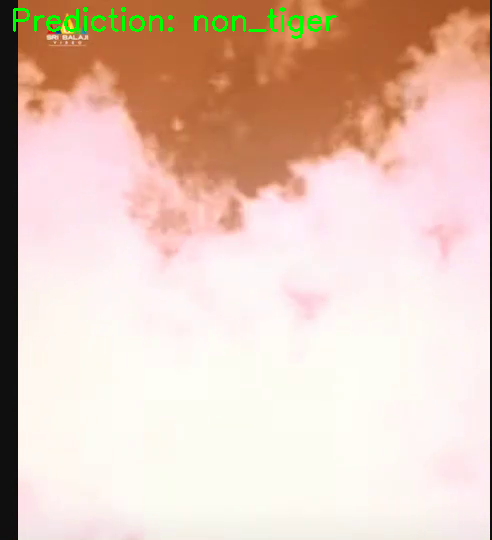

1/1 [==============================] - 0s 61ms/step


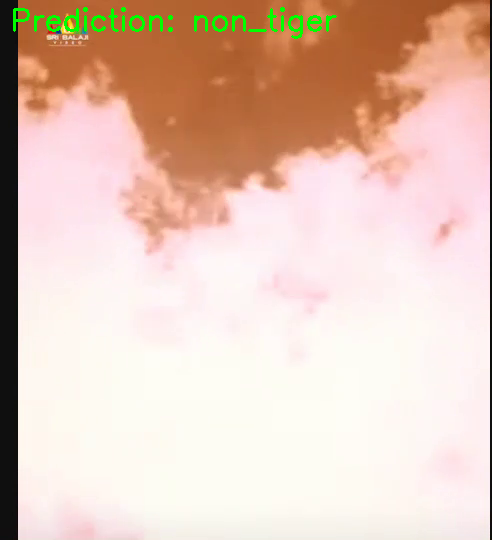

1/1 [==============================] - 0s 44ms/step


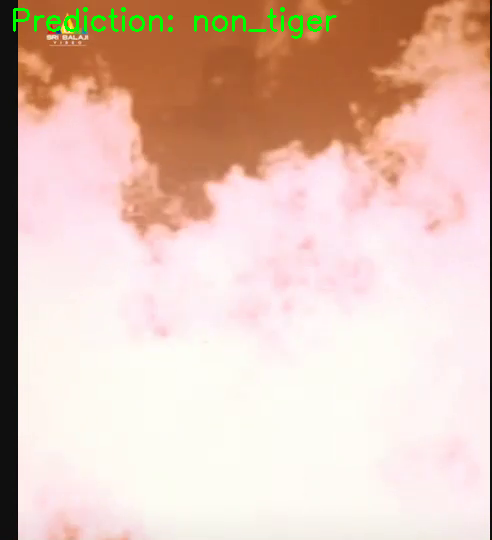

1/1 [==============================] - 0s 35ms/step


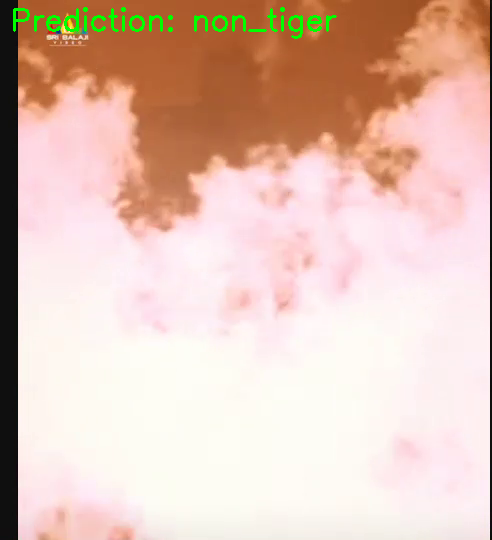

1/1 [==============================] - 0s 35ms/step


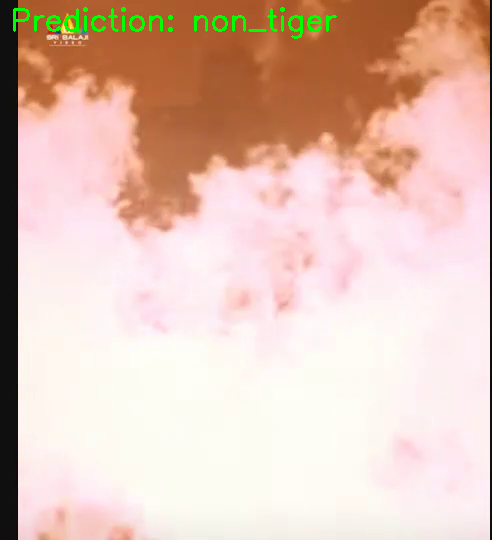

1/1 [==============================] - 0s 37ms/step


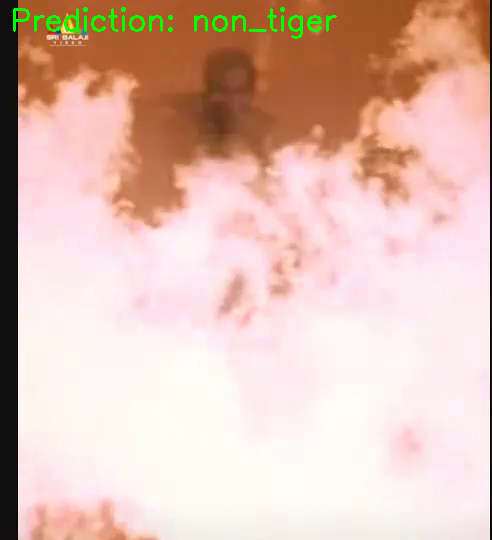

1/1 [==============================] - 0s 75ms/step


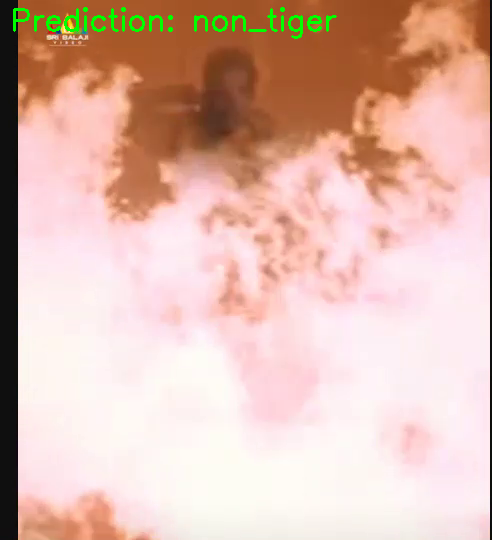

1/1 [==============================] - 0s 48ms/step


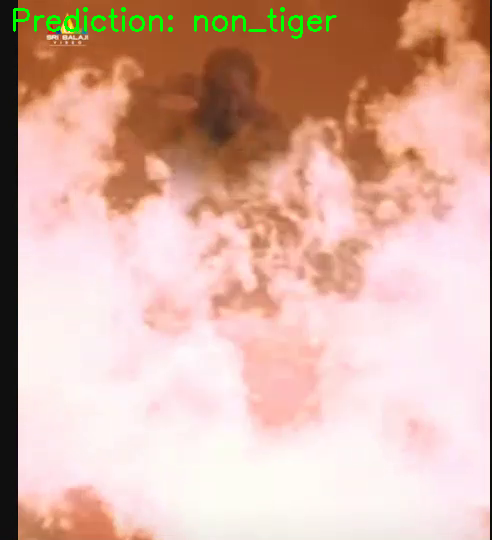

1/1 [==============================] - 0s 59ms/step


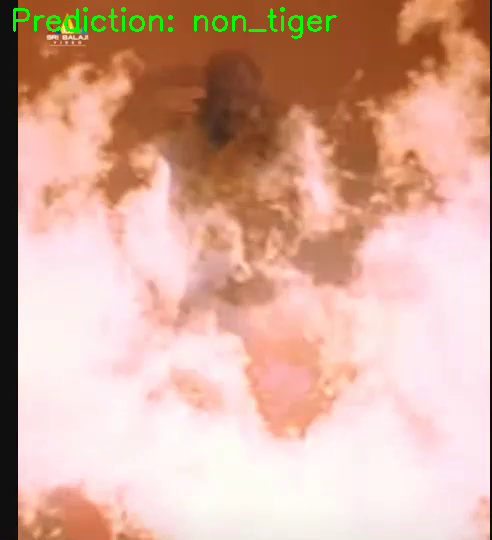

1/1 [==============================] - 0s 44ms/step


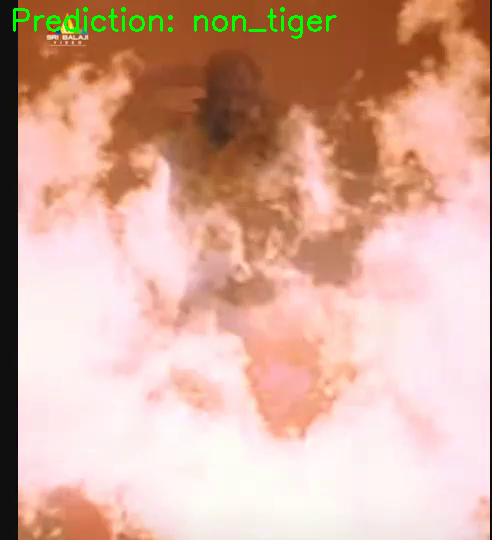

1/1 [==============================] - 0s 49ms/step


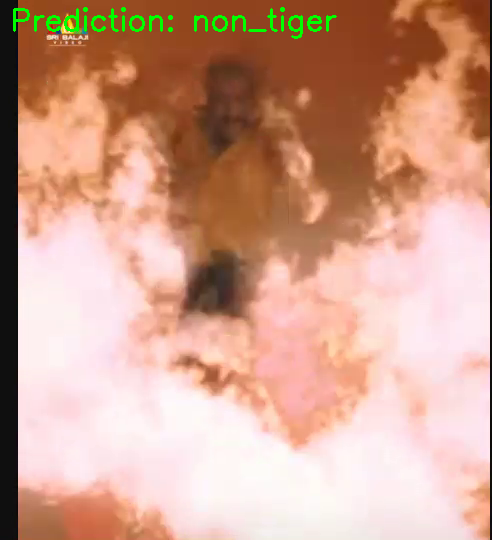

1/1 [==============================] - 0s 59ms/step


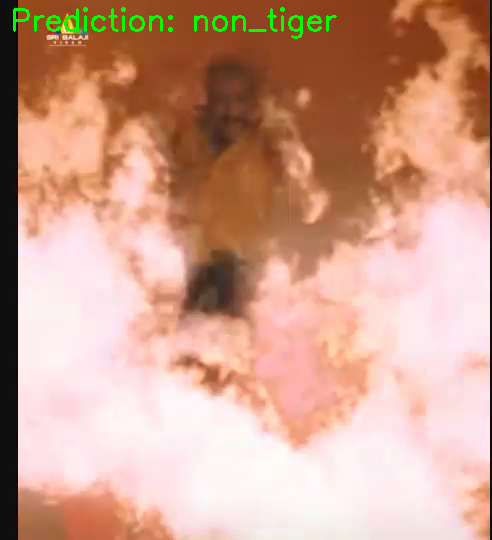

1/1 [==============================] - 0s 52ms/step


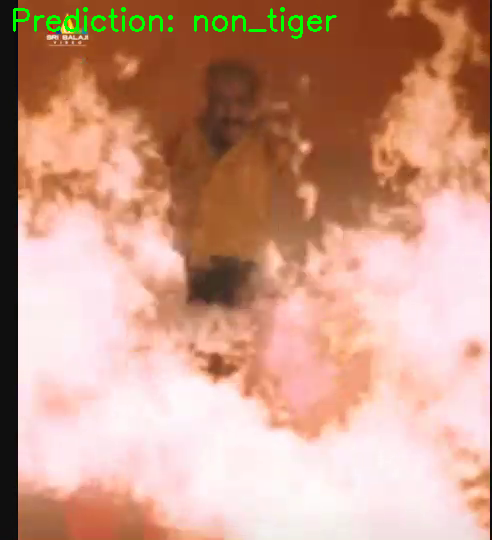

1/1 [==============================] - 0s 63ms/step


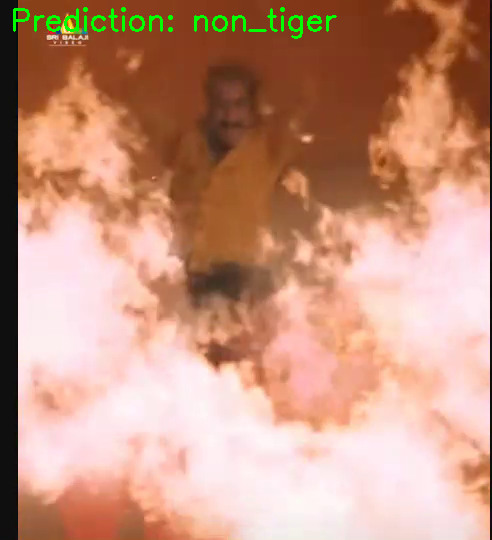

1/1 [==============================] - 0s 41ms/step


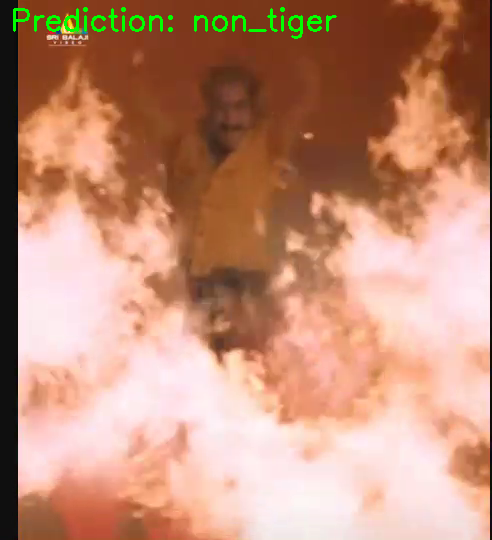

1/1 [==============================] - 0s 38ms/step


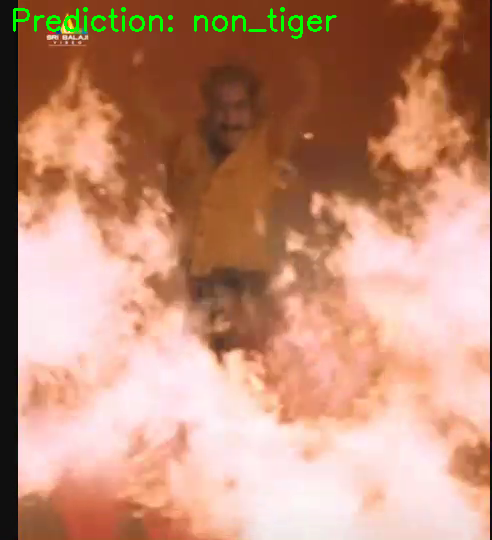

1/1 [==============================] - 0s 38ms/step


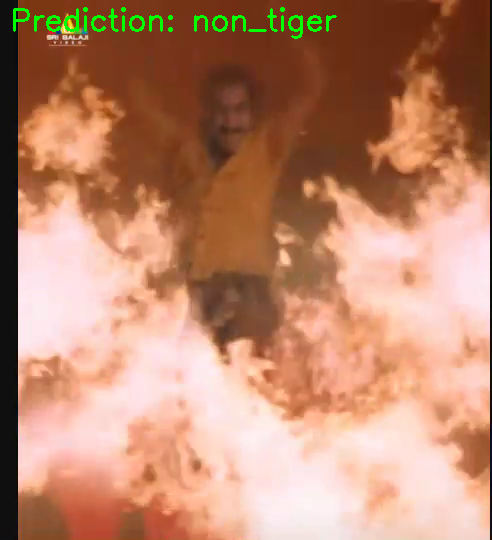

1/1 [==============================] - 0s 46ms/step


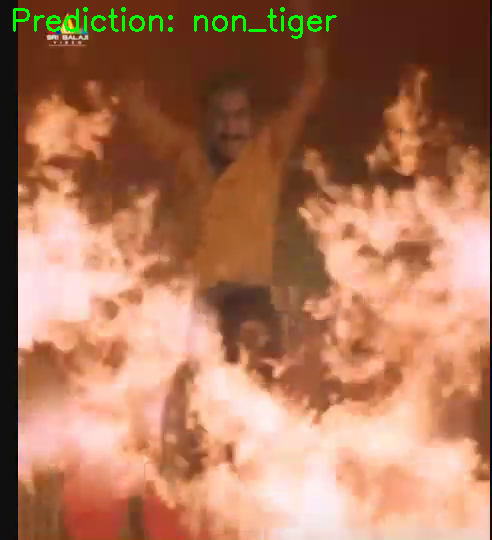

1/1 [==============================] - 0s 36ms/step


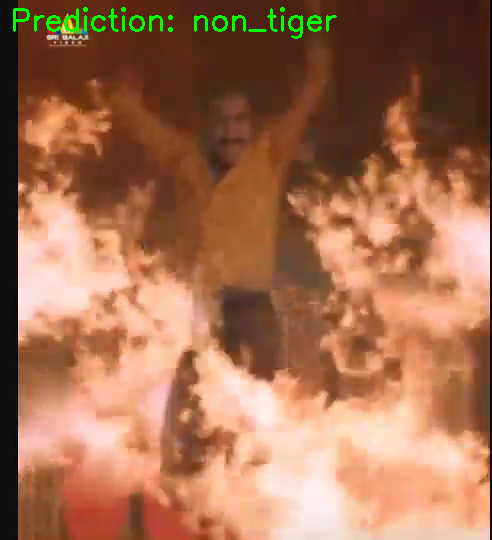

1/1 [==============================] - 0s 36ms/step


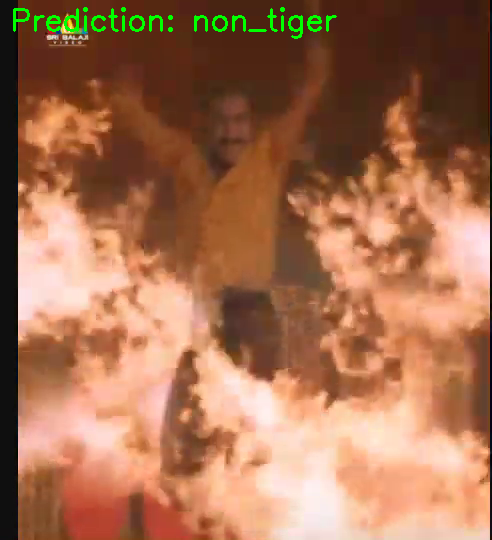

1/1 [==============================] - 0s 36ms/step


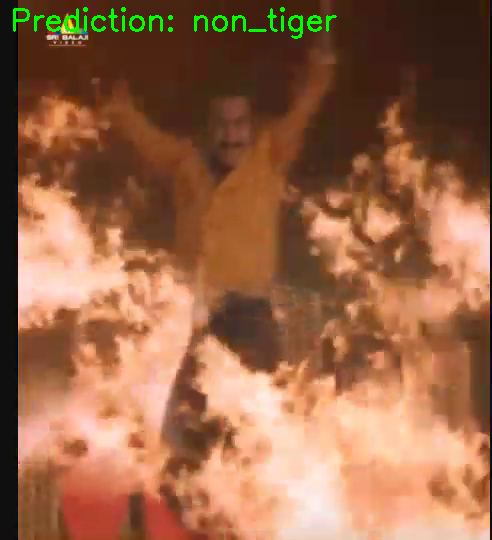

1/1 [==============================] - 0s 39ms/step


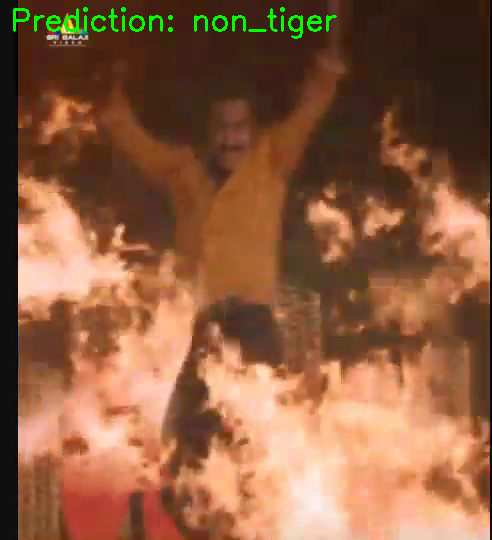

1/1 [==============================] - 0s 36ms/step


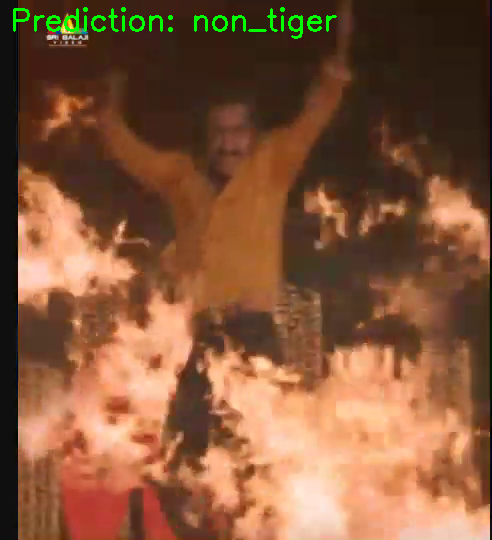

1/1 [==============================] - 0s 45ms/step


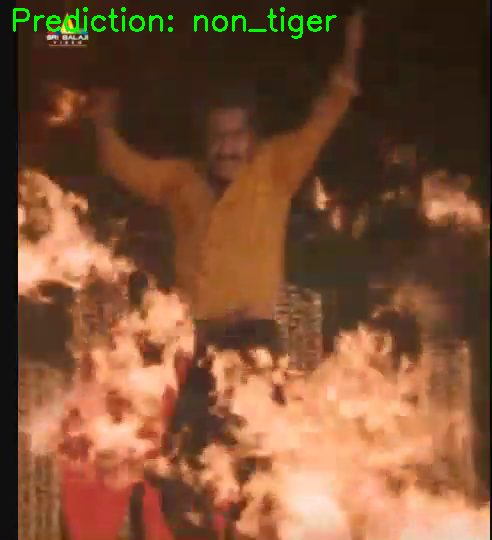

1/1 [==============================] - 0s 37ms/step


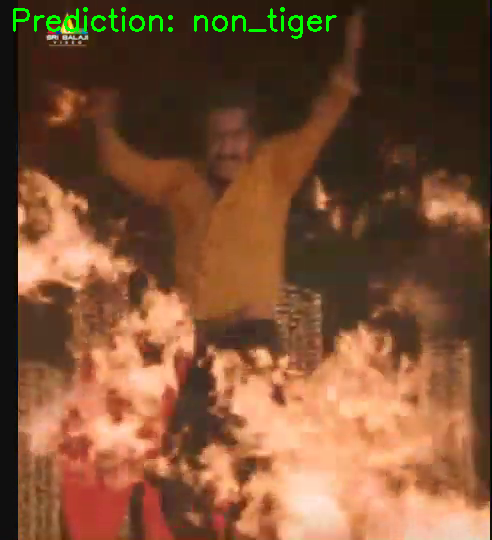

1/1 [==============================] - 0s 40ms/step


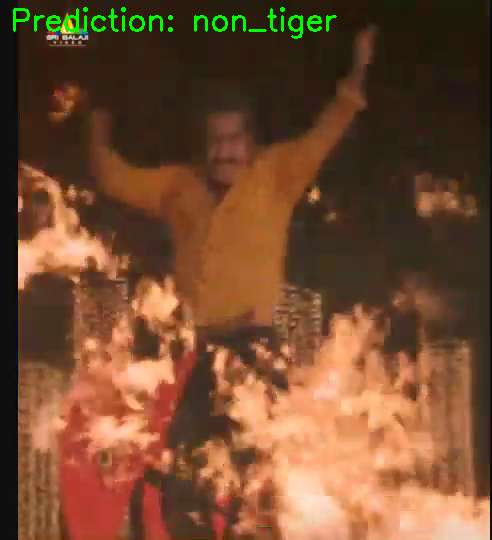

1/1 [==============================] - 0s 37ms/step


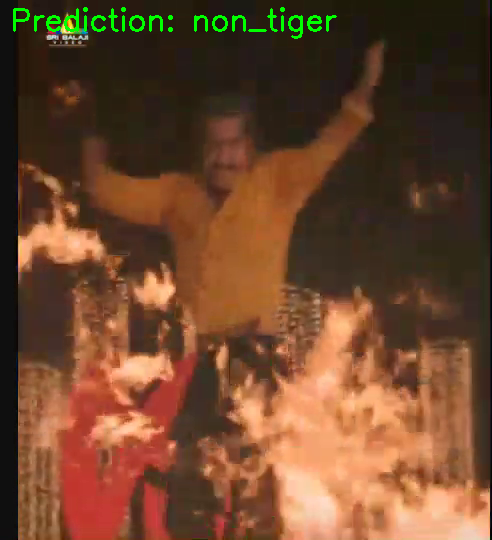

1/1 [==============================] - 0s 36ms/step


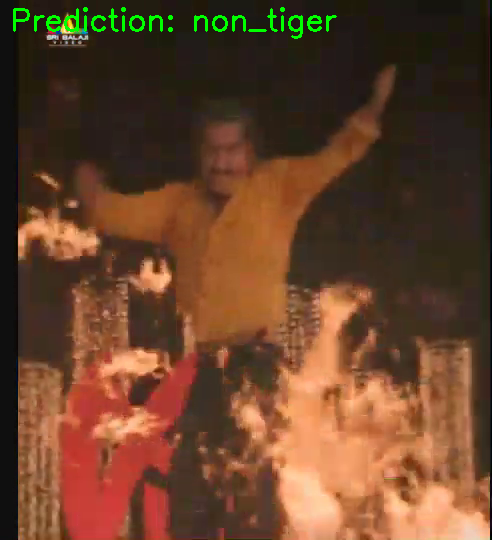

1/1 [==============================] - 0s 49ms/step


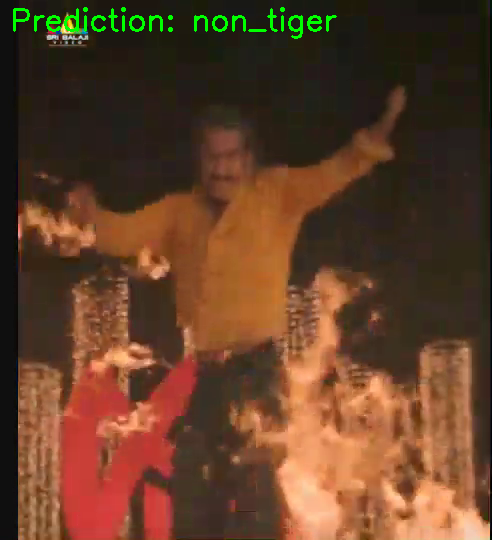

1/1 [==============================] - 0s 36ms/step


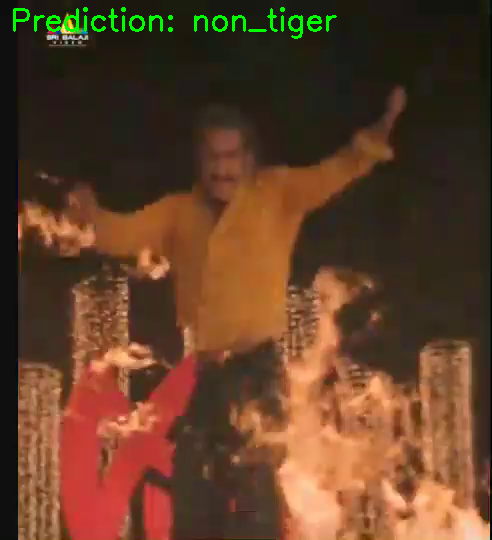

1/1 [==============================] - 0s 36ms/step


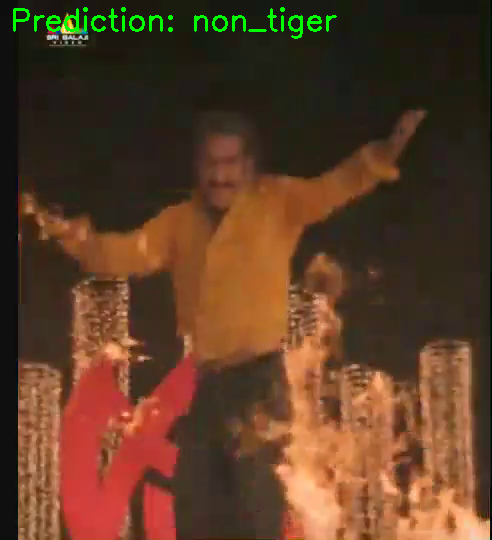

1/1 [==============================] - 0s 36ms/step


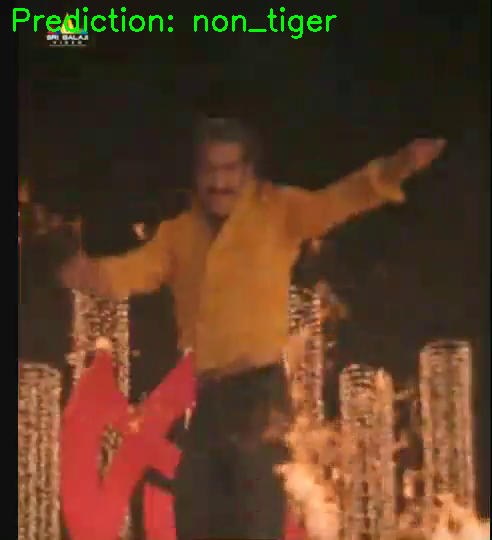

1/1 [==============================] - 0s 37ms/step


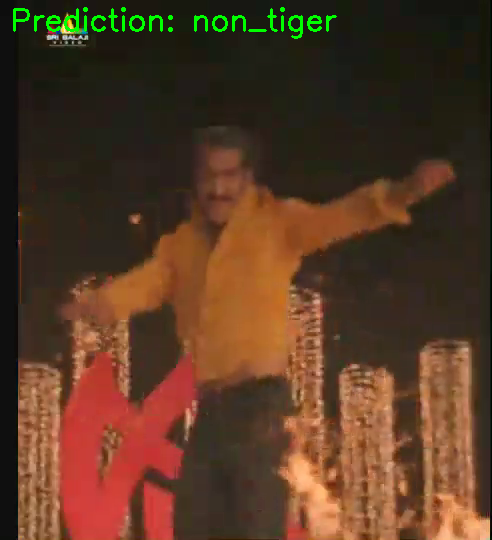

1/1 [==============================] - 0s 40ms/step


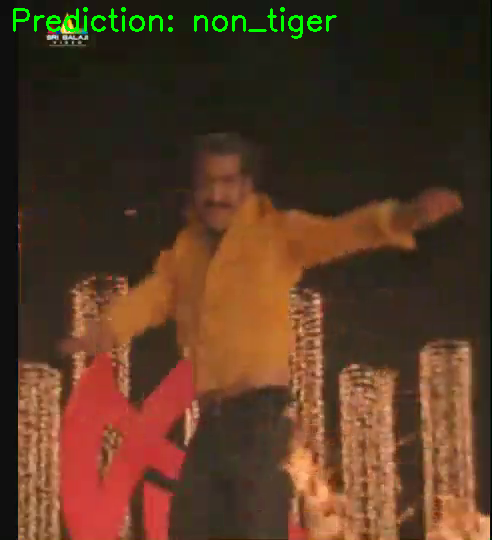

1/1 [==============================] - 0s 37ms/step


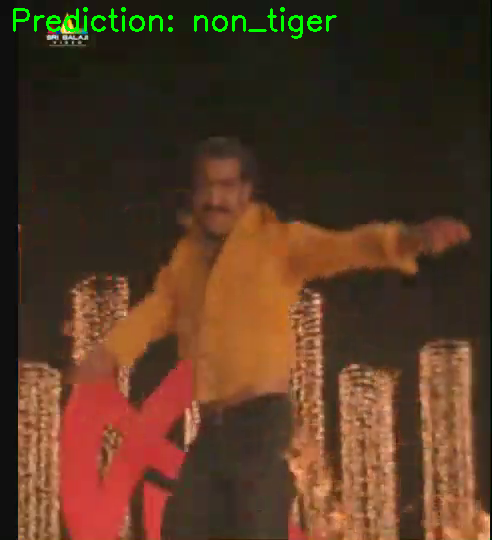

1/1 [==============================] - 0s 36ms/step


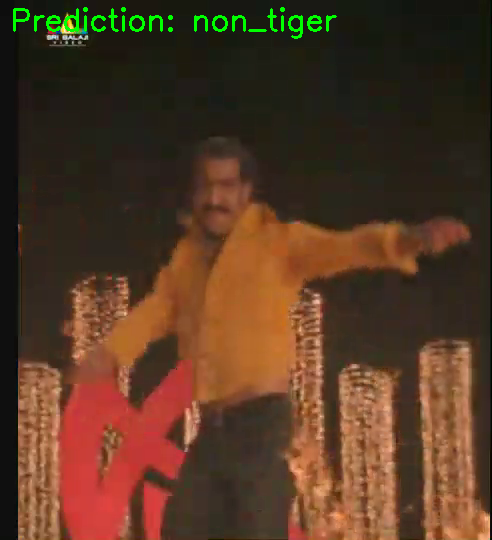

1/1 [==============================] - 0s 36ms/step


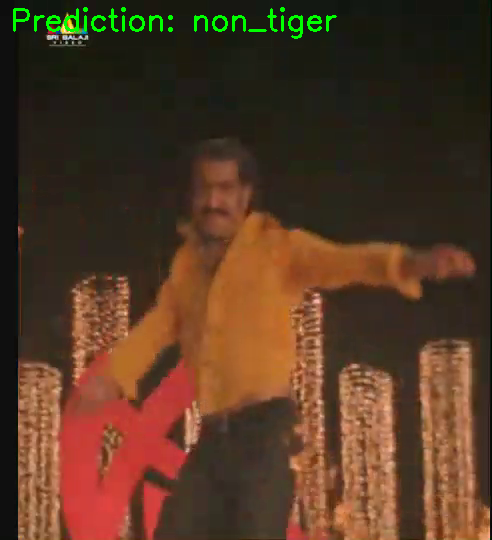

1/1 [==============================] - 0s 37ms/step


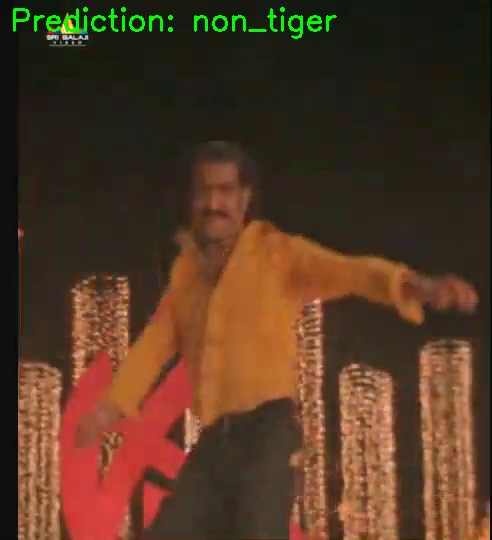

1/1 [==============================] - 0s 60ms/step


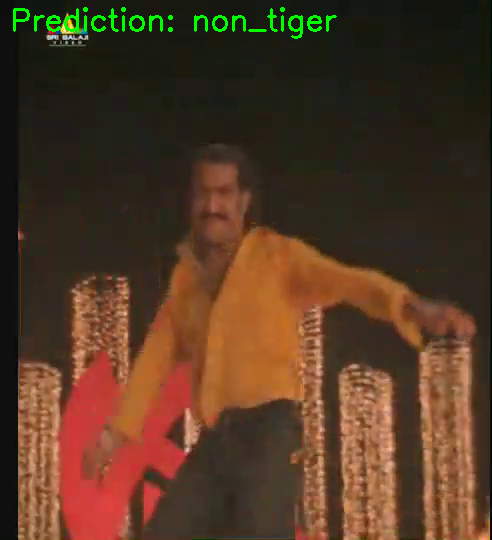

1/1 [==============================] - 0s 43ms/step


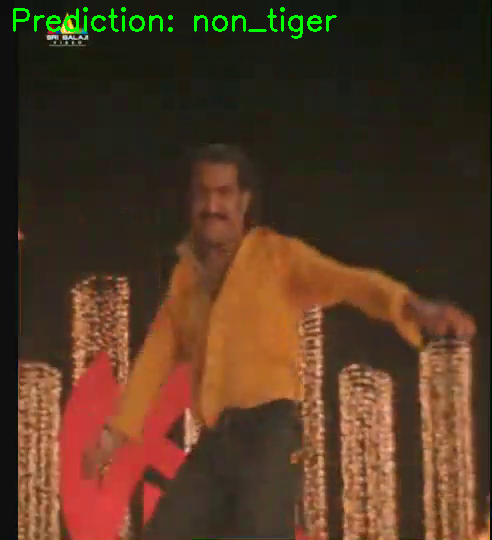

1/1 [==============================] - 0s 39ms/step


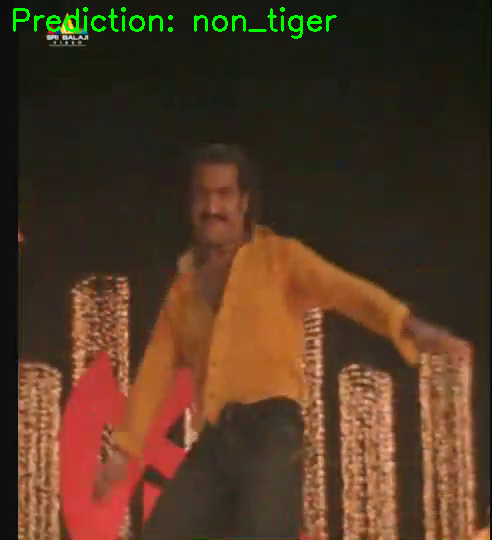

1/1 [==============================] - 0s 37ms/step


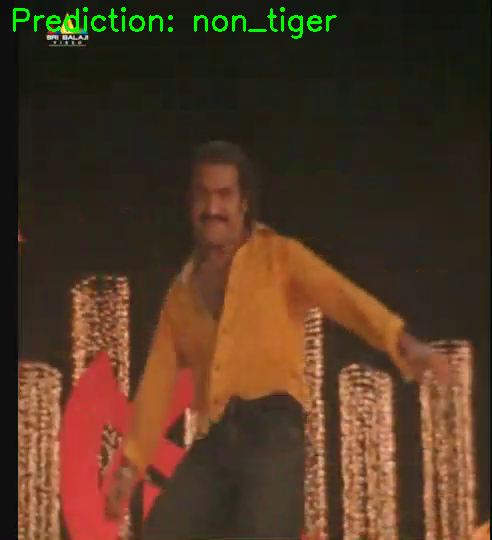

1/1 [==============================] - 0s 40ms/step


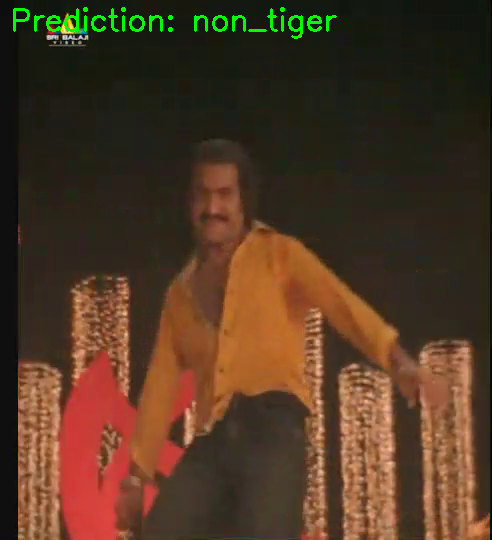

1/1 [==============================] - 0s 48ms/step


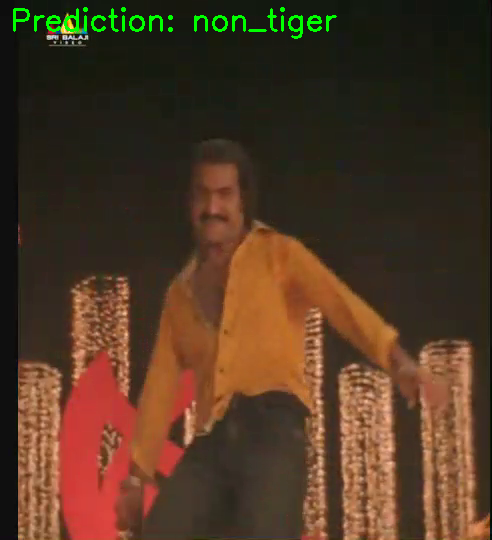

1/1 [==============================] - 0s 39ms/step


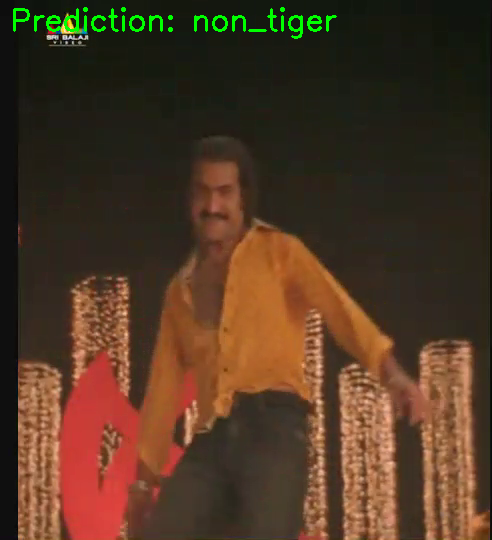

1/1 [==============================] - 0s 39ms/step


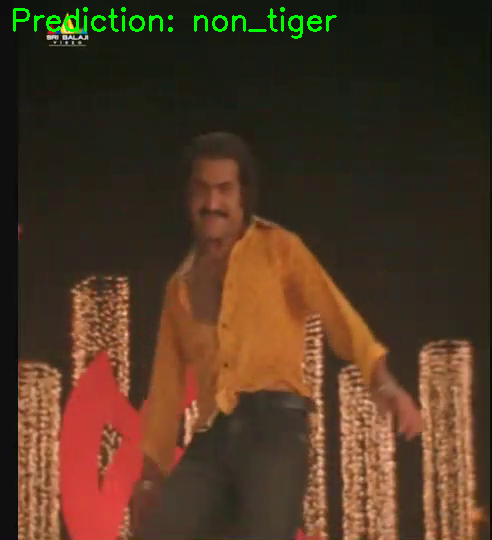

1/1 [==============================] - 0s 37ms/step


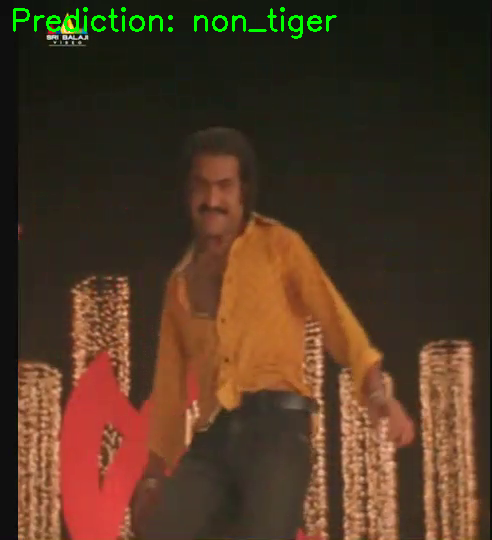

1/1 [==============================] - 0s 37ms/step


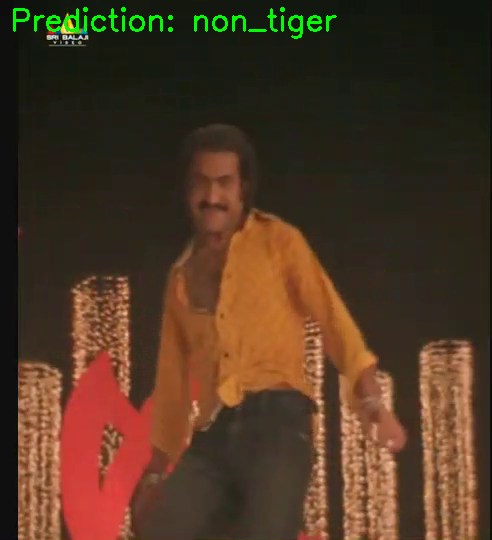

1/1 [==============================] - 0s 45ms/step


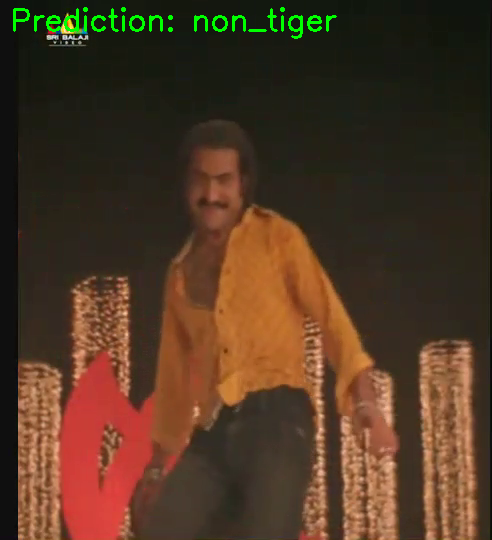

1/1 [==============================] - 0s 36ms/step


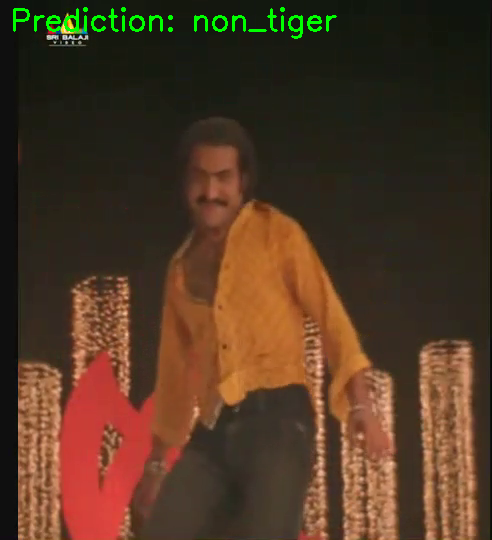

1/1 [==============================] - 0s 36ms/step


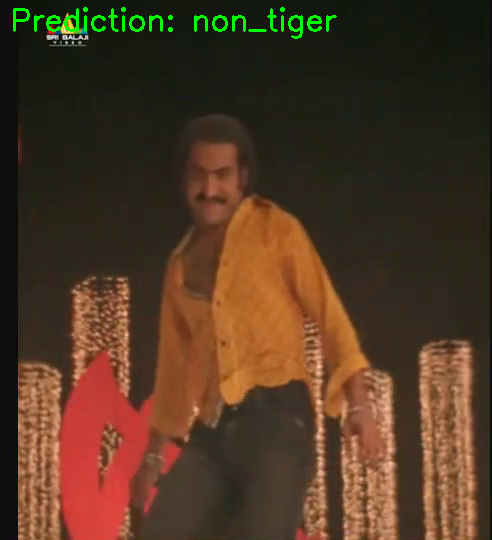

1/1 [==============================] - 0s 39ms/step


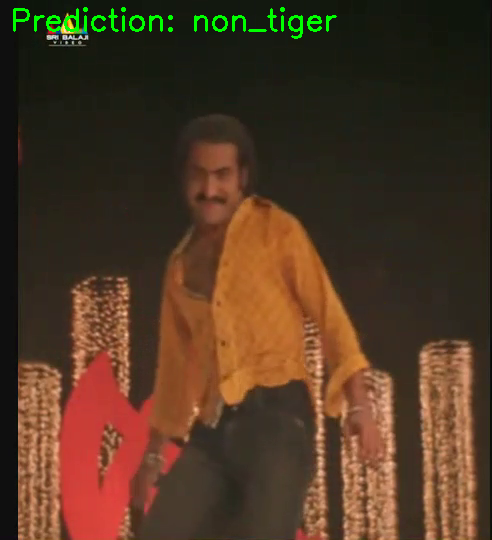

1/1 [==============================] - 0s 38ms/step


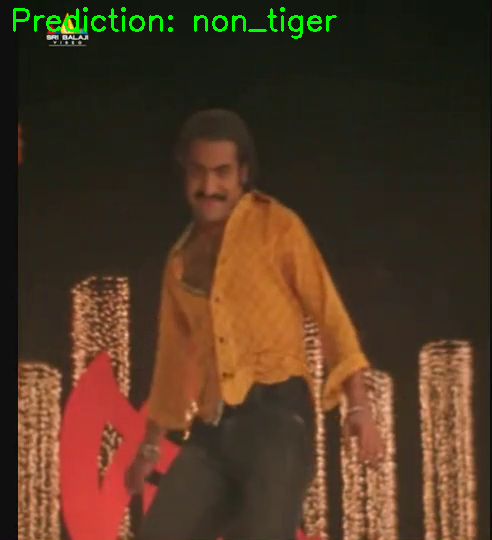

1/1 [==============================] - 0s 36ms/step


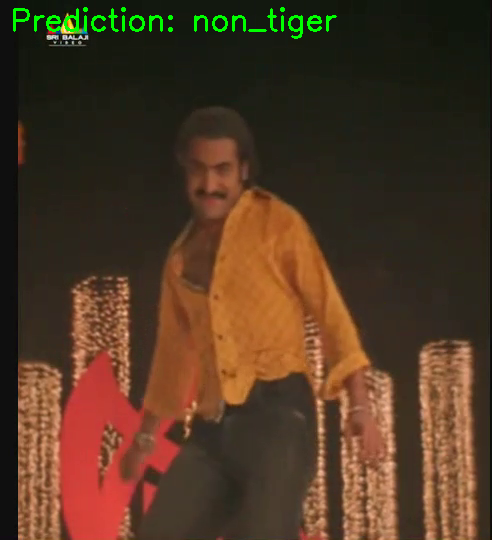

In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow

# Define a function to preprocess a frame
def preprocess_frame(frame, img_shape=299):  # Adjusted for Inception model
    frame = cv2.resize(frame, (img_shape, img_shape))
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame = frame / 255.0
    return frame

# Open the video file
cap = cv2.VideoCapture("/content/drive/MyDrive/puli31.mp4")

# Get video information
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create a VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
output_video = cv2.VideoWriter("/content/drive/MyDrive/outputydinv3_video.mp4", fourcc, fps, (width, height))

# Define the class names for your Inception model
class_names = ['tiger', 'non_tiger']  # Update with your actual class names

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Preprocess the frame
    processed_frame = preprocess_frame(frame)

    # Make prediction using the Inception model
    pred = new_inception_model.predict(tf.expand_dims(processed_frame, axis=0))
    pred_class = class_names[int(tf.round(pred)[0][0])]

    # Overlay the result on the frame
    cv2.putText(frame, f"Prediction: {pred_class}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Display the frame using cv2_imshow
    cv2_imshow(frame)

    # Write the frame to the output video
    output_video.write(frame)

    # Break the loop if 'q' key is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
output_video.release()
cv2.destroyAllWindows()